In [1]:
import os
import pathlib
import time
import re
import pickle
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
print(tf.__version__)

# plotting style options
font = {'size': 18}
matplotlib.rc('font', **font)
sns.set_theme()
sns.set(font_scale = 1.2)
%matplotlib inline 

2.7.0


# Contents

The notebook is structured as follows:
1. Introduction 
- 1.1. Problem statement
- 1.2. Proposed solution
2. Exploration of the dataset
- 2.1. Correlations
- 2.2. Time series plots
- 2.3. Histograms 
3. Pre-processing
- 3.1. Addition of higher-order derivatives of input features (velocity, acceleration, jerk, snap, crackle, pop)  
- 3.2. Scaling of input features and outputs
- 3.3. Preparing input features for RNN training 
- 3.4. Splitting of data into train/validation/test sets
4. Modeling
- 4.1. Linear regression
- 4.2. DNN regression
- 4.3. RNN regression
5. Evaluation
- 5.1. Loss on test sets
- 5.2. Prediction error
- 5.3. Time series plots of prediction vs. ground truth
6. Summary and prospects

# 1. Introduction

## 1.1. Problem statement
- Two opposing robots, R1 and R2, apply pressure onto a metal sheet to deform it. 
- Each robot can move in $x, y, z$, and (roll, pitch, yaw) $a, b, c$.
- R1 (the "forming robot") pushes into the sheet ($z$) while moving along a path in $x$/$y$-plane, parallel to the sheet metal surface.
- R2 (the opposing "support robot") pushes into the sheet from the other side. 
- Both robots experience forces at the tool-tip in $x, y,$ and $z$ directions. 
- Positions, angles, and tool-tip forces are captured for each robot. 

**Deliverables**:
 - Develop a model to predict forces experienced by tool-tips for any path traveled by the robot arms
 - Provide a Jupyter notebook that includes all the steps 

## 1.2. Proposed solution

The problem is to find a function $G$ to predict tool-tip forces from position coordinates: 
$$
\vec{f} = G(x,y,z,a,b,c)
$$
Models like these could be solved using a parametrized dynamical model with Lagrange or Newton-Euler methods assuming rigid body motion. However, instead of doing that, I'm going to **approximate $G$ with a neural network**. 

Here are a few sources I looked at for inspiration:
- http://www.scholarpedia.org/article/Robot_dynamics
- https://ethz.ch/content/dam/ethz/special-interest/mavt/robotics-n-intelligent-systems/rsl-dam/documents/RobotDynamics2016/6-dynamics.pdf
- https://towardsdatascience.com/approximating-dynamic-models-of-industrial-robots-with-neural-networks-2474d1a2eecd
- https://www.nature.com/articles/s41598-021-97003-1.pdf
- https://www.tensorflow.org/tutorials/keras/regression
- https://www.tensorflow.org/guide/keras/rnn


# 2. Exploration of the dataset

Before training a model, it is always good to look at the data. Let's have a look at time series plots, histograms, and correlations.

### Import the datasets into pd.DataFrame

In [2]:
workdir = pathlib.Path("./")


# create a timestamp for tagging saved models
timestamp = time.strftime("%Y%m%d_%H%M")

# output directory for saved models, plots, etc.
output_dir = workdir / 'olsson_solution_{}'.format(timestamp)
output_dir.mkdir(parents=True, exist_ok=True)

dataset_filenames = ["Test1", "Test2", "Test4"]

# list of dataframes
datasets = list()
print("loading datasets:")
for filename in dataset_filenames:
    print("-", workdir / str(filename+'.csv'))
    datasets.append(pd.read_csv(workdir / str(filename+'.csv')))

loading datasets:
- Test1.csv
- Test2.csv
- Test4.csv


### Look at a summary of what's in the dataframe

In [3]:
print("First five entries: \n", datasets[0].head(5).T)

First five entries: 
                     0             1             2             3             4
t        1.636580e+09  1.636580e+09  1.636580e+09  1.636580e+09  1.636580e+09
a_enc_1 -4.951100e+00 -4.951100e+00 -4.951100e+00 -4.951100e+00 -4.951100e+00
b_enc_1  1.830000e-02  1.830000e-02  1.830000e-02  1.830000e-02  1.830000e-02
c_enc_1 -7.190000e-02 -7.190000e-02 -7.190000e-02 -7.190000e-02 -7.190000e-02
x_enc_1  2.136337e+02  2.136337e+02  2.136337e+02  2.136337e+02  2.136337e+02
y_enc_1  3.241015e+02  3.241015e+02  3.241015e+02  3.241015e+02  3.241015e+02
z_enc_1  8.953528e+02  8.953528e+02  8.953528e+02  8.953528e+02  8.953528e+02
a_enc_2 -1.549772e+02 -1.549772e+02 -1.549772e+02 -1.549772e+02 -1.549772e+02
b_enc_2  2.023000e-01  2.024000e-01  2.024000e-01  2.024000e-01  2.024000e-01
c_enc_2 -1.798798e+02 -1.798798e+02 -1.798798e+02 -1.798798e+02 -1.798798e+02
x_enc_2  2.232210e+01  2.232040e+01  2.232040e+01  2.232040e+01  2.232040e+01
y_enc_2  7.831761e+02  7.831754e+02  7.831

In [4]:
print("\ndescribe():\n", datasets[0].describe().T[['count', 'mean', 'std', 'min', 'max']])


describe():
            count          mean          std           min           max
t        20091.0  1.636590e+09  5800.523780  1.636580e+09  1.636600e+09
a_enc_1  20091.0 -8.924334e+01     7.811876 -9.001034e+01 -4.951004e+00
b_enc_1  20091.0  8.760533e-04     0.002961 -1.604445e-02  2.338158e-02
c_enc_1  20091.0  1.884124e-03     0.007390 -7.199558e-02  2.159353e-02
x_enc_1  20091.0  4.578387e+02   197.669145  8.937531e+01  8.306894e+02
y_enc_1  20091.0  1.965825e+02   103.805836 -1.773652e+00  3.672685e+02
z_enc_1  20091.0 -6.500421e+01   100.980291 -1.767849e+02  8.953528e+02
a_enc_2  20091.0  8.804365e+01    22.349876 -1.783886e+02  1.789519e+02
b_enc_2  20091.0  1.449096e-03     0.029150 -2.199676e+00  1.164570e+00
c_enc_2  20091.0 -4.858466e+01   173.319815 -1.800000e+02  1.800000e+02
x_enc_2  20091.0  4.560382e+02   202.637762  2.231891e+01  8.318730e+02
y_enc_2  20091.0  1.995663e+02   120.025141 -3.800164e+00  7.831773e+02
z_enc_2  20091.0 -7.605120e+01    81.255998 -7.725

### Make separate lists of input features (position coordinates and euler angles) and outputs (forces)

In [5]:
#features = [k for k in datasets[0].keys() if not re.search('^f', k) and 't' not in k]
#outputs = [k for k in datasets[0].keys() if re.search('^f', k)]

features_1 = [i+'_enc_1' for i in 'xyzabc']
features_2 = [i+'_enc_2' for i in 'xyzabc']
outputs_1 = ['fx_1', 'fy_1', 'fz_1']
outputs_2 = ['fx_2', 'fy_2', 'fz_2']
features = features_1 + features_2
outputs = outputs_1 + outputs_2

print('features:', features)
print('outputs:', outputs)

features: ['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2']
outputs: ['fx_1', 'fy_1', 'fz_1', 'fx_2', 'fy_2', 'fz_2']


## 2.1. Correlations

### First look at correlations for R1 and R2 separately, for simplicity


seaborn.pairplot can be helpful to get an idea of correlations

<Figure size 1440x1440 with 0 Axes>

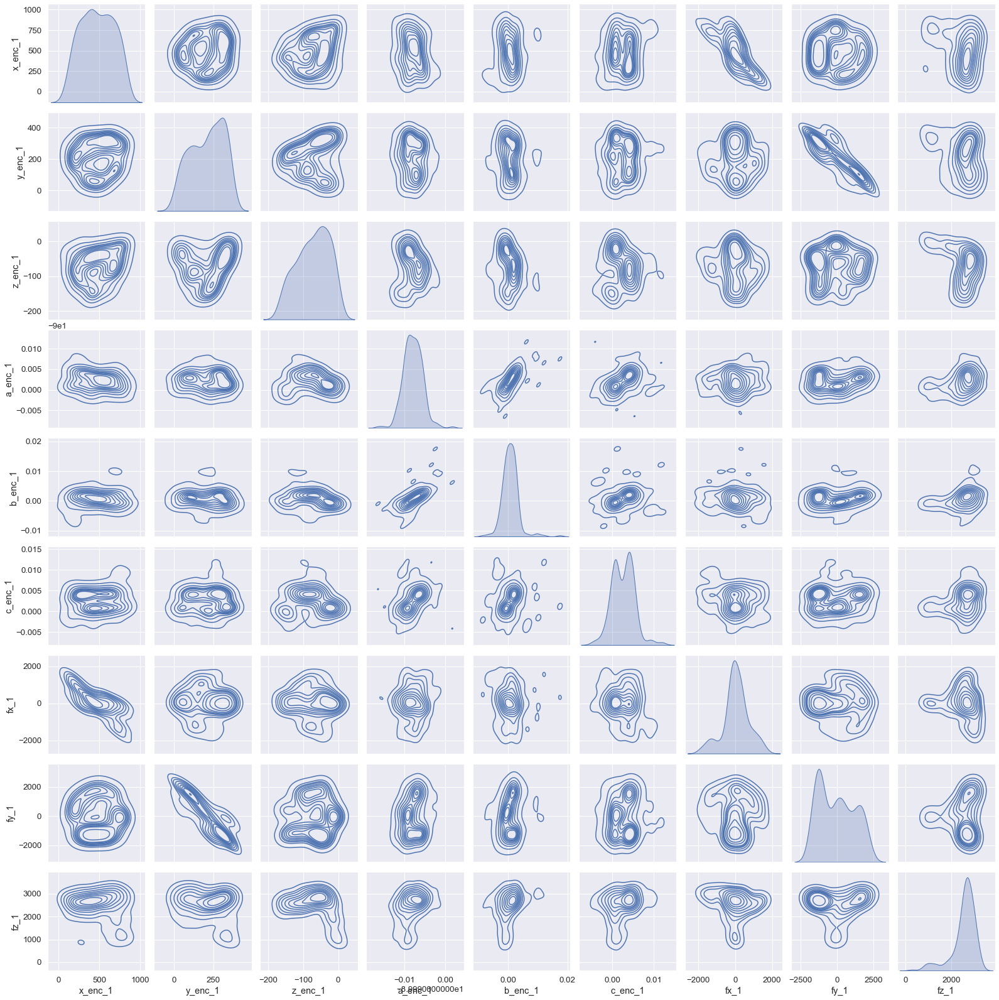

<Figure size 1440x1440 with 0 Axes>

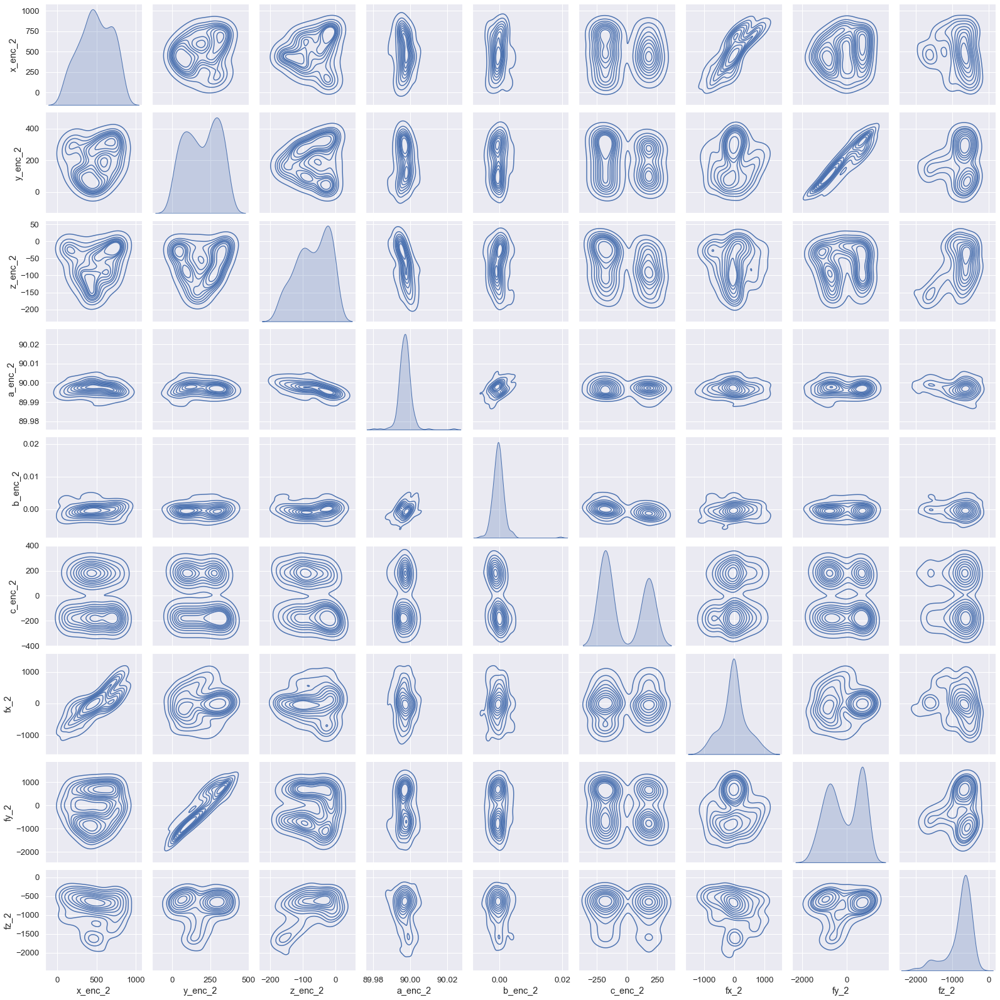

In [6]:
# pair plots (slow...)
labels = [features_1+outputs_1, features_2+outputs_2]
for robot_idx in range(2):
    fig = plt.figure(figsize=(20, 20))
    sns.pairplot(datasets[0].sample(200)[labels[robot_idx]], kind='kde')
    plt.savefig(output_dir/'pairplot_robot{}.pdf'.format(robot_idx+1))

#### Plot correlation matrices

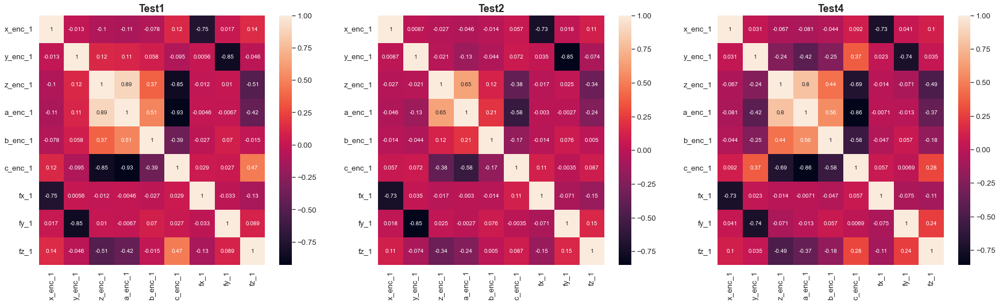

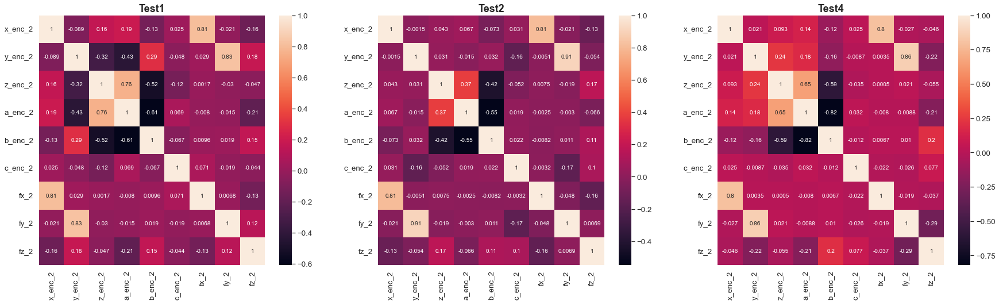

In [7]:
sns.set_style("whitegrid")
labels = [features_1+outputs_1, features_2+outputs_2]
for robot_idx in range(2):
    fig = plt.figure(figsize=(10*len(datasets), 8))
    for i,df in enumerate(datasets):
        corr = df[labels[robot_idx]].corr()
        ax = fig.add_subplot(1, len(datasets), i+1)
        ax.set_title(dataset_filenames[i], weight='bold').set_fontsize('18')
        sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_robot{}.pdf'.format(robot_idx+1))

**Observations:**
- Forces $f_x$ and $f_y$ are strongly correlated with positions $x$ and $y$ respectively and relatively weakly related to anything else. 
- $f_z$ is mainly correlated to $z$, but also quite strongly correlated with $a$ (roll) and $c$ (yaw), especially for R1.


### Now let's look at correlations between R1 and R2

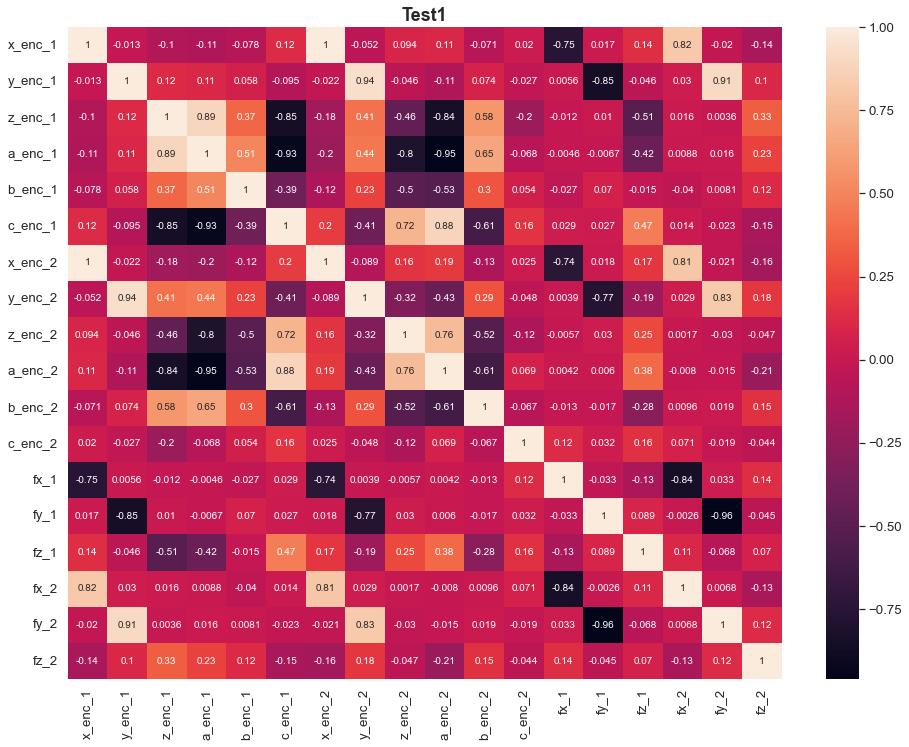

In [8]:
dataset_idx = 0 # Test1
labels = features_1+features_2+outputs_1+outputs_2
fig = plt.figure(figsize=(16, 12))
corr = datasets[dataset_idx][labels].corr()
ax = fig.add_subplot(111)
ax.set_title(dataset_filenames[dataset_idx], weight='bold').set_fontsize('18')
sns.set_style("whitegrid")
sns.heatmap(corr, annot=True)
plt.savefig(output_dir/'corr_{}_both_robots.pdf'.format(dataset_filenames[dataset_idx]))

**Observations:**
- Strong correlations between $x_1$, $x_2$, $f_{x_1}$, and $f_{x_2}$ and between $y_1$, $y_2$, $f_{y_1}$, and $f_{y_2}$ which seems reasonable given the motion of the two robots.
- Relatively weak correlation between $f_{z_1}$ and $f_{z_2}$. Forces in $z$ have quite strong correlation to $a,b$, and $c$.


## 2.2. Time series plots


#### Plot varables in dataset to see what things look like

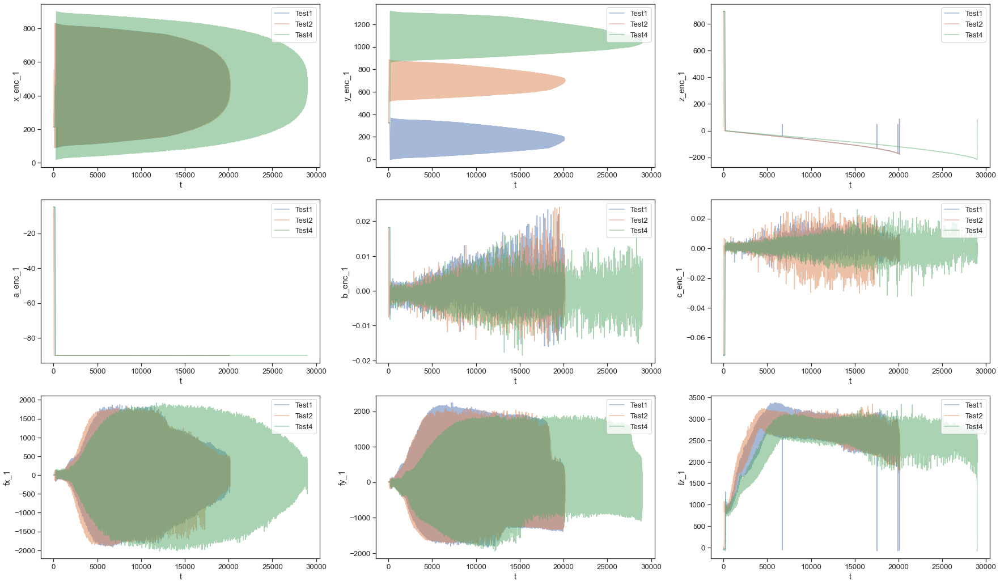

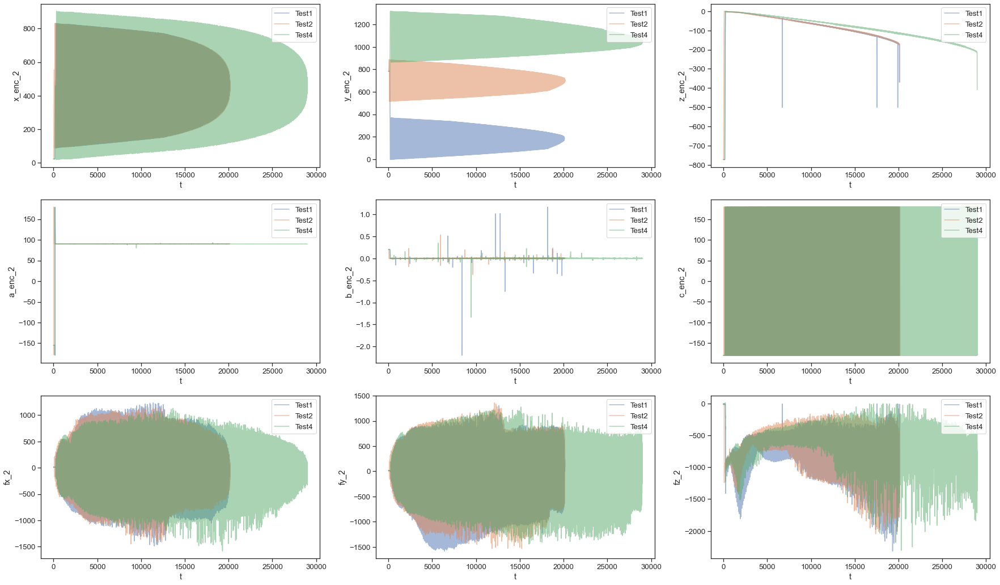

In [9]:
sns.set_style("ticks")
variables_to_plot = [i+'_enc' for i in 'xyzabc'] + ['fx', 'fy', 'fz']
for robot_idx in range(2):
    fig = plt.figure(figsize=(30,18))
    for i,k in enumerate(variables_to_plot):
        k += '_{}'.format(robot_idx+1)
        ax = fig.add_subplot(3,3, i+1)
        for j in range(len(datasets)):
            # shift 't' to start at 0 for each dataset
            ax.plot(datasets[j]['t']-min(datasets[j]['t']), datasets[j][k], label=dataset_filenames[j], alpha=0.5)
        ax.set_xlabel('t', y=0.5)
        ax.set_ylabel(k, y=0.5)
        ax.legend(loc=1)
    fig.savefig(output_dir/'1d_variables_vs_time_robot{}.pdf'.format(robot_idx+1))

## 2.3. Histograms 

#### Make histograms of varables in dataset

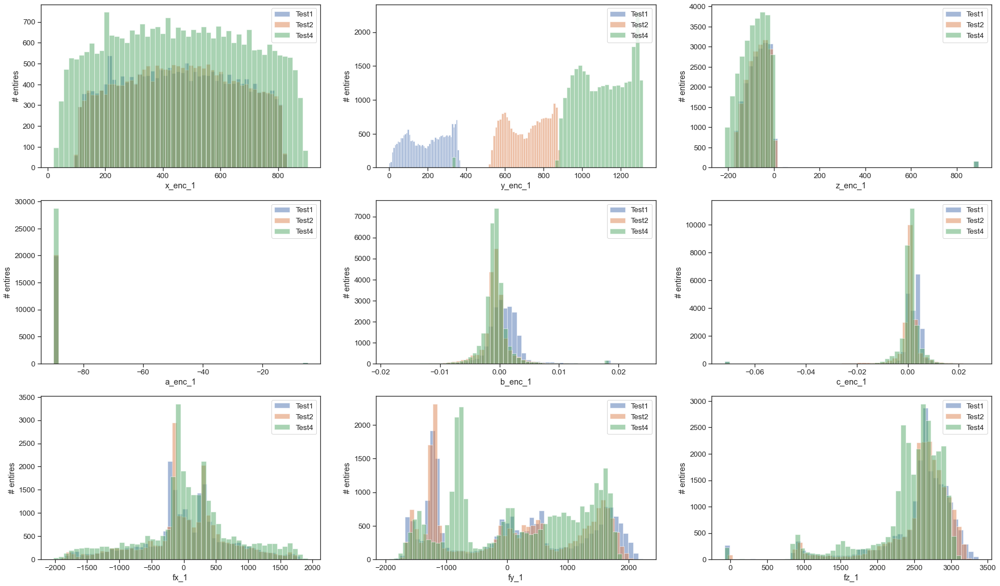

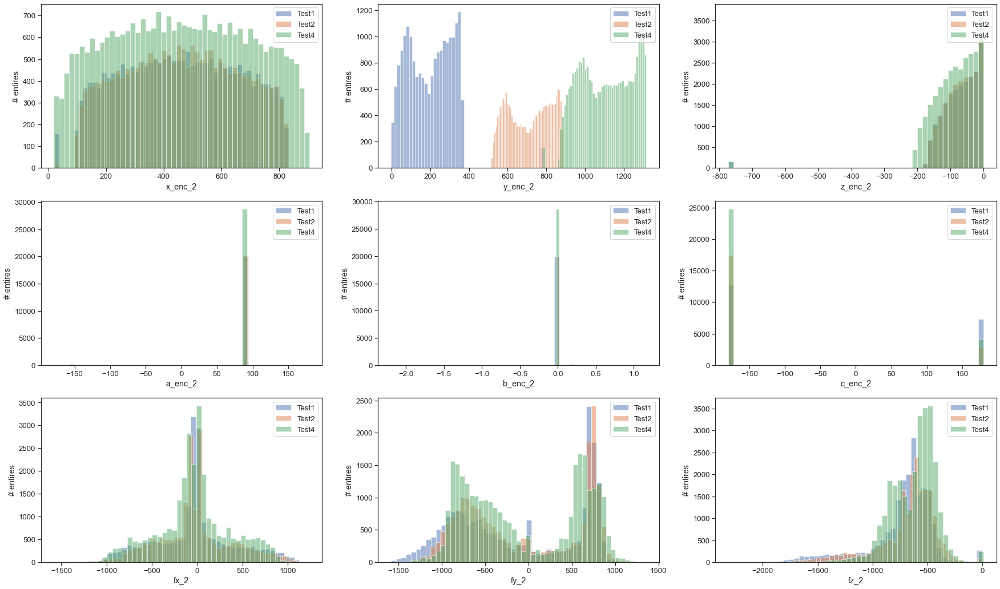

In [10]:
sns.set_style("ticks")
variables_to_plot = [i+'_enc' for i in 'xyzabc'] + ['fx', 'fy', 'fz']
for robot_idx in range(2):
    fig = plt.figure(figsize=(30,18))
    for i,k in enumerate(variables_to_plot):
        k += '_{}'.format(robot_idx+1)
        ax = fig.add_subplot(3,3, i+1)
        for j in range(len(datasets)):
            ax.hist(datasets[j][k], label=dataset_filenames[j], bins=50, alpha=0.5)
        ax.set_xlabel(k, y=0.5)
        ax.set_ylabel('# entires', y=0.5)
        ax.legend(loc=1)
    fig.savefig(output_dir/'1d_hists_robot{}.pdf'.format(robot_idx+1))

# 3. Pre-processing

## 3.1. Addition of higher-order derivatives of input features

I noticed that the models could more accurately predict forces from motion in datasets not seen during training when adding higher-order derivatives of the position coordinates as input features.

First (velocity) and second (acceleration) order derivatives had a notable effect on the performance (more about that in section 4). I also tried to include up to 6th order derivatives (3rd=jerk, 4th=snap, 5th=crackle, 6th=pop) [1]. These had a smaller impact but did help in some cases.

[1] https://en.wikipedia.org/wiki/Fourth,_fifth,_and_sixth_derivatives_of_position

In [11]:
# differentiate variables in dataframe
def add_gradients(df, keys_to_diff, nth_order=1):
    for k in keys_to_diff:
        df['d'+str(nth_order)+'_'+re.sub('d\d_','', k)] = np.gradient(df[k])

In [12]:
# add derivatives of position and euler angles:
# 1=velocity, 2=acceleration, 3=jerk, 4=snap, 5=crackle, 6=pop
nth_order = 6
features_to_diff = features
for n in range(1, nth_order+1):
    for df in datasets:
        add_gradients(df, features_to_diff, n)
    features_to_diff = [k for k in datasets[0].keys() if re.search('^d{:d}'.format(n), k)]

#### Create feature lists

In [13]:
# x-axis only
features_x1 = ['x_enc_1'] + ["d{:d}_x_enc_1".format(i) for i in range(1,7)]
features_x2 = ['x_enc_2'] + ["d{:d}_x_enc_2".format(i) for i in range(1,7)]
outputs_x1 = ['fx_1']
outputs_x2 = ['fx_2']

In [14]:
def generate_feature_list(arm_idx, nth_order=6):
    features = []
    for i in 'xyzabc':
        features.append('{}_enc_{}'.format(i, arm_idx))
    for i in 'xyzabc':
        for j in range(1,nth_order+1):
            features.append('d{}_{}_enc_{}'.format(j, i, arm_idx))
    return features

In [15]:
# up to 6th order derivatives (velocity, acceleration, jerk, snap, crackle, pop)
features_1_nth = generate_feature_list(1, nth_order)
features_2_nth = generate_feature_list(2, nth_order)

# up to 2nd order derivatives (velocity, acceleration)
features_1_2nd = generate_feature_list(1, 2)
features_2_2nd = generate_feature_list(2, 2)

outputs_1 = ['fx_1', 'fy_1', 'fz_1']
outputs_2 = ['fx_2', 'fy_2', 'fz_2']

### Correlations to higher order derivatives

#### $x$-axis only

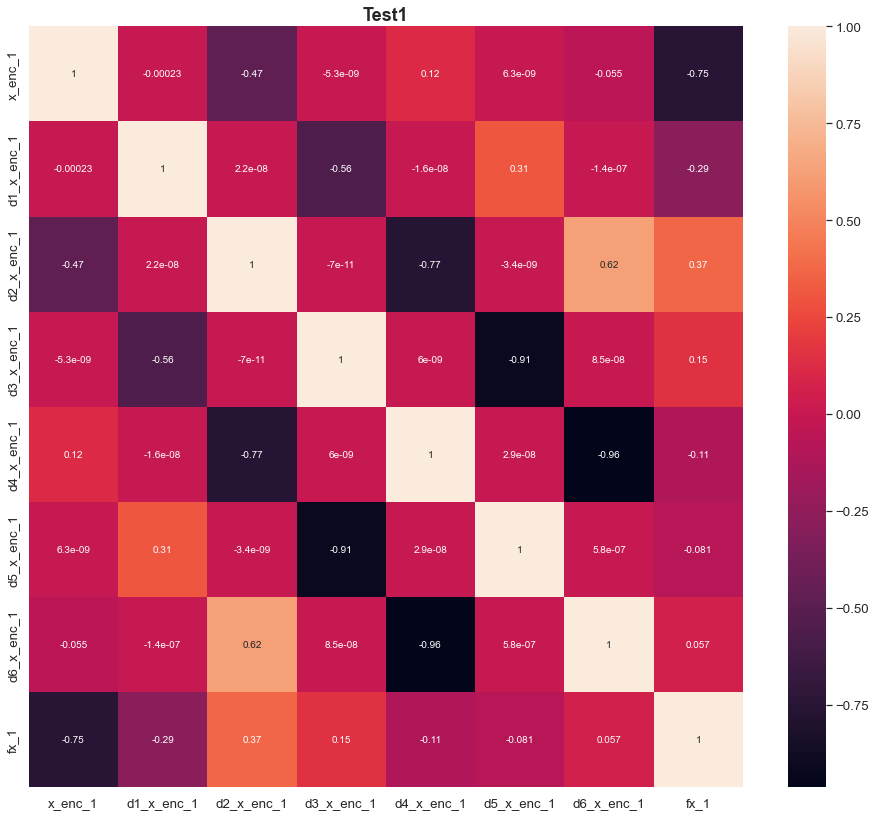

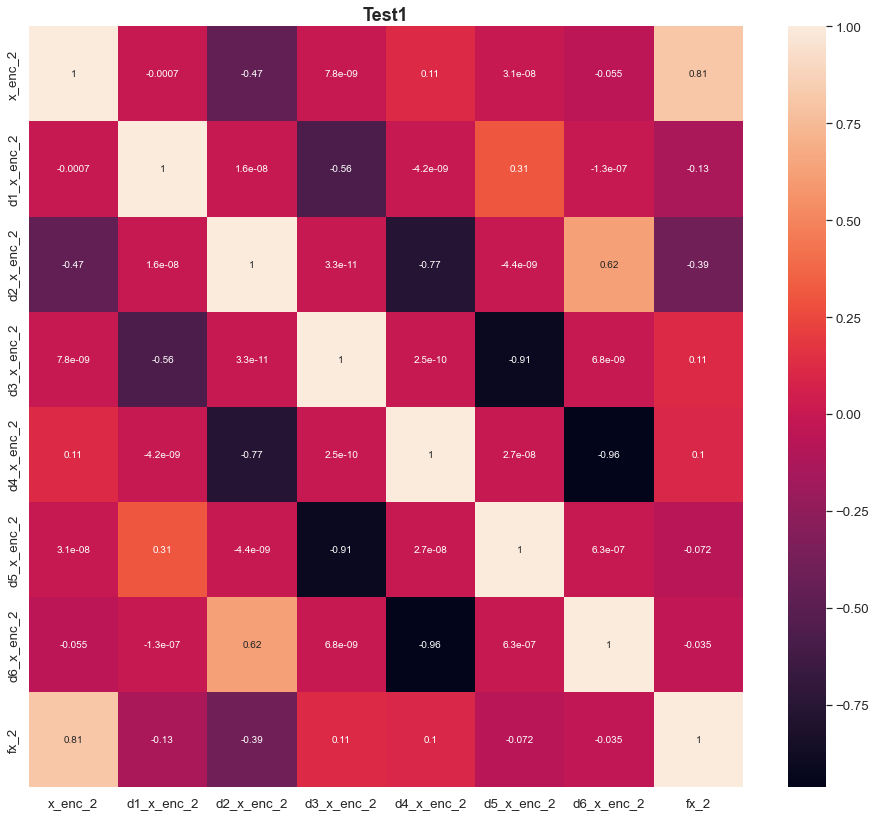

In [16]:
idx = 0 # Test1
labels = [features_x1+outputs_x1, features_x2+outputs_x2]
sns.set_style("whitegrid")
for robot_idx in range(2):
    fig = plt.figure(figsize=(16, 14))
    corr = datasets[idx][labels[robot_idx]].corr()
    ax = fig.add_subplot(111)
    ax.set_title(dataset_filenames[idx], weight='bold').set_fontsize('18')
    sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_derivatives_x_robot{}.pdf'.format(robot_idx+1))

#### All coordinates

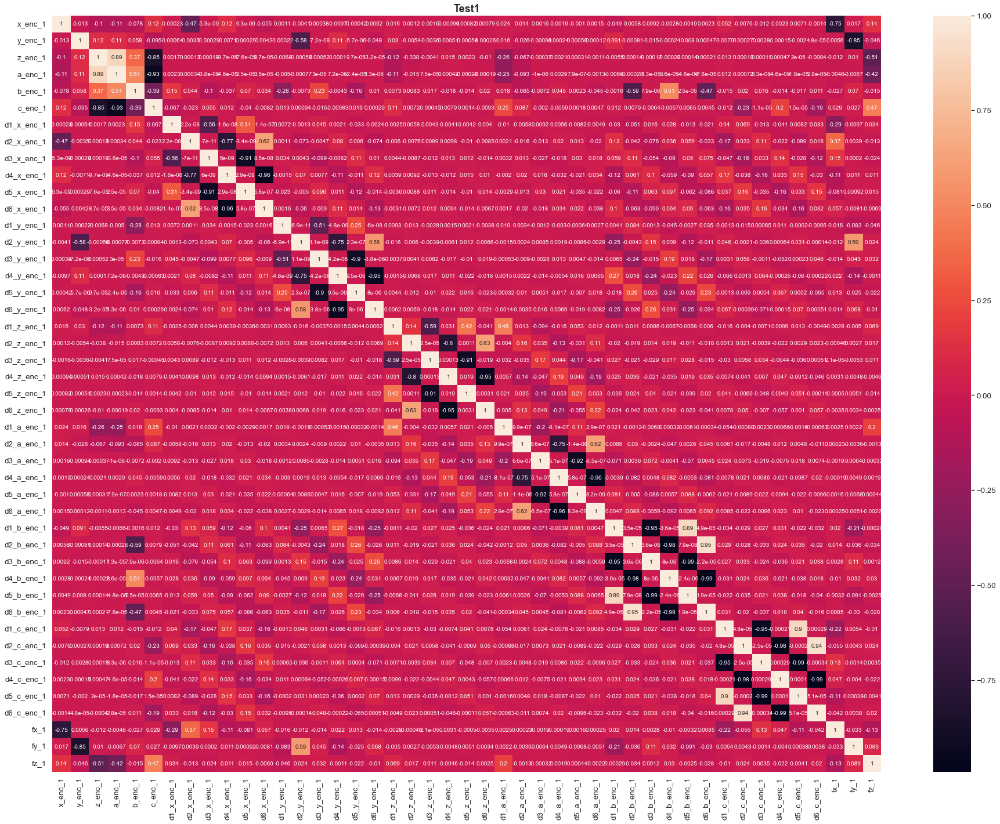

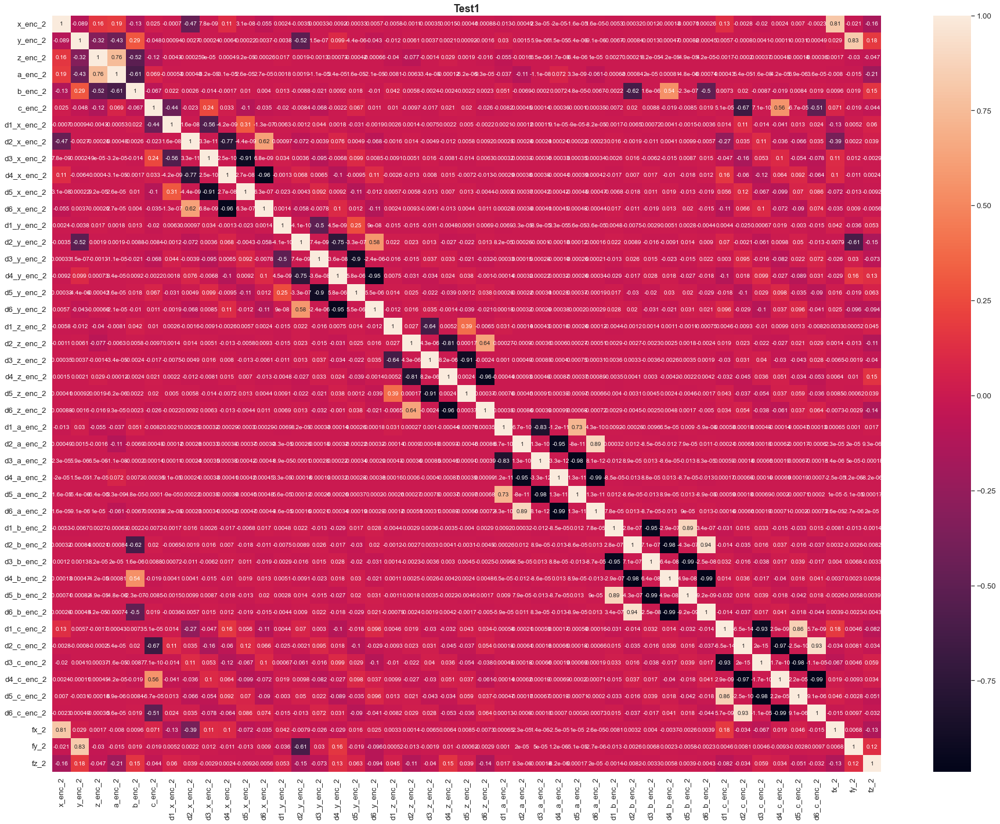

In [17]:
idx = 0 # Test1
labels = [features_1_nth+outputs_1, features_2_nth+outputs_2]
sns.set_style("whitegrid")
for robot_idx in range(2):
    fig = plt.figure(figsize=(32, 24))
    corr = datasets[idx][labels[robot_idx]].corr()
    ax = fig.add_subplot(111)
    ax.set_title(dataset_filenames[idx], weight='bold').set_fontsize('18')
    sns.heatmap(corr, annot=True)
    plt.savefig(output_dir/'corr_derivatives_all_robot{}.pdf'.format(robot_idx+1))

## 3.2. Scaling of input features and outputs

### Specify which datasets to use
Hold out 'Test2' for testing of model trained on data from 'Test1' and 'Test4'.

In [18]:
df1 = datasets[0] # Test1
df2 = datasets[1] # Test2
df4 = datasets[2] # Test4
df = df1.copy()
#df = df.append(datasets[1])
df = df.append(datasets[2])

#### Split dataframe into X (features) and Y (outputs)

In [19]:
features_nth = features_1_nth + features_2_nth
features_2nd = features_1_2nd + features_2_2nd
X = df[features_nth].to_numpy()
Y = df[outputs].to_numpy()
print(X.shape, Y.shape)

(49078, 84) (49078, 6)


#### Feature scaling
Both MinMaxScaler and StandardScaler were tried, the former gave slightly more robust performance.

In [20]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
#scaler_x = StandardScaler()
#scaler_y = StandardScaler()
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()
X_normed = scaler_x.fit_transform(X)
Y_normed = scaler_y.fit_transform(Y)

In [21]:
# sanity check
print(X[0:5,0])
print(X_normed[0:5,0])
print(scaler_x.inverse_transform(X_normed)[0:4,0])

[213.6337 213.6337 213.6337 213.6337 213.6337]
[0.21954808 0.21954808 0.21954808 0.21954808 0.21954808]
[213.6337 213.6337 213.6337 213.6337]


## 3.3. Preparing input features for RNN training

Including multiple time steps of the input features and training an RNN to predict forces improved the performance over using a DNN. After some experimentation, I concluded that about 20 timesteps worked pretty well.

In [22]:
def split_sequences(X, Y, n_steps):
    X_seq, Y_seq = list(), list()
    for i in range(len(X)):
        end_i = i + n_steps
        if end_i > len(X):
            break
        Xi, yi = X[i:end_i, :], Y[end_i-1, :]
        X_seq.append(Xi)
        Y_seq.append(yi)
    return (np.array(X_seq), np.array(Y_seq))

In [23]:
# prepare sequences for RNN with 20 time steps
n_steps = 20
X_seq, Y_seq = split_sequences(X_normed, Y_normed, n_steps)
print(X_seq.shape, Y_seq.shape)

(49059, 20, 84) (49059, 6)


## 3.4. Splitting of data into train/validation/test sets


In [24]:
from sklearn.model_selection import train_test_split
# if False: keep last events for testing
shuffle = True
# 70-10-20 train-validation-test split
train_frac = 0.7
val_frac = 0.1

# for dnn
X_train, X_val_test, Y_train, Y_val_test = train_test_split(X_normed, Y_normed, train_size = train_frac, shuffle=shuffle)
X_val, X_test, Y_val, Y_test = train_test_split(X_val_test, Y_val_test, test_size = 1.0-val_frac/(1.0-train_frac), shuffle=False)

print(X_train.shape, Y_train.shape)
print(X_val.shape, Y_val.shape)
print(X_test.shape, Y_test.shape)

# for rnn
X_seq_train, X_seq_val_test, Y_seq_train, Y_seq_val_test = train_test_split(X_seq, Y_seq, train_size = train_frac, shuffle=shuffle)
X_seq_val, X_seq_test, Y_seq_val, Y_seq_test = train_test_split(X_seq_val_test, Y_seq_val_test, test_size = 1.0-val_frac/(1.0-train_frac), shuffle=False)

print(X_seq_train.shape, Y_seq_train.shape)
print(X_seq_val.shape, Y_seq_val.shape)
print(X_seq_test.shape, Y_seq_test.shape)

(34354, 84) (34354, 6)
(4907, 84) (4907, 6)
(9817, 84) (9817, 6)
(34341, 20, 84) (34341, 6)
(4905, 20, 84) (4905, 6)
(9813, 20, 84) (9813, 6)


#### Create train/val/test sets with 12 (positions and angles) and 36 input features (positions, angles, and up to 2nd order derivatives)

In [25]:
# sanity check
print(features)
print(features_2nd)
print(outputs)

['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2']
['x_enc_1', 'y_enc_1', 'z_enc_1', 'a_enc_1', 'b_enc_1', 'c_enc_1', 'd1_x_enc_1', 'd2_x_enc_1', 'd1_y_enc_1', 'd2_y_enc_1', 'd1_z_enc_1', 'd2_z_enc_1', 'd1_a_enc_1', 'd2_a_enc_1', 'd1_b_enc_1', 'd2_b_enc_1', 'd1_c_enc_1', 'd2_c_enc_1', 'x_enc_2', 'y_enc_2', 'z_enc_2', 'a_enc_2', 'b_enc_2', 'c_enc_2', 'd1_x_enc_2', 'd2_x_enc_2', 'd1_y_enc_2', 'd2_y_enc_2', 'd1_z_enc_2', 'd2_z_enc_2', 'd1_a_enc_2', 'd2_a_enc_2', 'd1_b_enc_2', 'd2_b_enc_2', 'd1_c_enc_2', 'd2_c_enc_2']
['fx_1', 'fy_1', 'fz_1', 'fx_2', 'fy_2', 'fz_2']


In [26]:
# indices of 12 position input features
feature_idx = [df[features_nth].columns.get_loc(col) for col in features]
# indices of position, velocity, and acceleration input features
feature_idx_2nd = [df[features_nth].columns.get_loc(col) for col in features_2nd]
# indices of all features
feature_idx_nth = [df[features_nth].columns.get_loc(col) for col in features_nth]

In [27]:
# sanity check
print(df[features][4000:4001].to_numpy())
print(scaler_x.inverse_transform(X_normed)[:,feature_idx][4000:4001,:])

[[ 7.01138030e+02  9.05163185e+01 -2.66579203e+01 -8.99984769e+01
  -4.16576996e-04  2.06331677e-03  7.04664055e+02  8.46991898e+01
  -2.02531592e+01  8.99942266e+01 -2.56791472e-04 -1.79998530e+02]]
[[ 7.01138030e+02  9.05163185e+01 -2.66579203e+01 -8.99984769e+01
  -4.16576996e-04  2.06331677e-03  7.04664055e+02  8.46991898e+01
  -2.02531593e+01  8.99942266e+01 -2.56791472e-04 -1.79998530e+02]]


In [28]:
# select 12 input features: x,y,z,a,b,c for robots 1 and 2
X_train_12 = X_train[:,feature_idx]
X_val_12 = X_val[:,feature_idx]
X_test_12 = X_test[:,feature_idx]

X_seq_train_12 = X_seq_train[:,:,feature_idx]
X_seq_val_12 = X_seq_val[:,:,feature_idx]
X_seq_test_12 = X_seq_test[:,:,feature_idx]

# select 36 input features: x,y,z,a,b,c + 1st and 2nd order derivatives for robots 1 and 2
X_train_36 = X_train[:,feature_idx_2nd]
X_val_36 = X_val[:,feature_idx_2nd]
X_test_36 = X_test[:,feature_idx_2nd]

X_seq_train_36 = X_seq_train[:,:,feature_idx_2nd]
X_seq_val_36 = X_seq_val[:,:, feature_idx_2nd]
X_seq_test_36 = X_seq_test[:,:,feature_idx_2nd]

In [29]:

# sanity check
print(X_train_12.shape)
print(X_seq_train_12.shape)

print(X_train_36.shape)
print(X_seq_train_36.shape)

(34354, 12)
(34341, 20, 12)
(34354, 36)
(34341, 20, 36)


# 4. Modeling

Finally, we're getting to the exciting part of training some neural nets.

In [30]:
# function to plot loss, to be used several times below
def plot_loss(history, name, title=''):
    fig = plt.figure(figsize=(24,10))
    fig.suptitle(title)
    
    # full range
    ax = fig.add_subplot(121)
    ax.plot(history.history['loss'], label='loss')
    ax.plot(history.history['val_loss'], label='val_loss')
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Error')
    ax.legend()
    ax.grid(True)
    
    # last 30 percent of epochs
    zoom_frac = 0.7
    nepochs = len(history.history['loss'])
    ax = fig.add_subplot(122)
    ax.plot(history.history['loss'], label='loss')
    ax.plot(history.history['val_loss'], label='val_loss')
    xmin = int(zoom_frac*nepochs)
    xmax = nepochs
    ax.set_xlim([xmin, xmax])
    ymin = 0.99*np.min(history.history['loss'][int(zoom_frac*nepochs):]
                      + history.history['val_loss'][int(zoom_frac*nepochs):])
    ymax = 1.01*np.max(history.history['loss'][int(zoom_frac*nepochs):] 
                      + history.history['val_loss'][int(zoom_frac*nepochs):])
    ax.set_ylim([ymin, ymax])
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Error')
    ax.legend()
    ax.grid(True)
    
    plt.savefig(output_dir/name)


In [31]:
# for comparing test results of different models
test_results = dict()

## 4.1. Linear Regression
Let's start with a simple linear regression.

### Predict $f_{x_1}$ from $x_1$

In [32]:
x1_train = X_train[:,0].reshape(len(X_train),1)
fx1_train = Y_train[:,0].reshape(len(Y_train),1)
x1_val = X_val[:,0].reshape(len(X_val),1)
fx1_val = Y_val[:,0].reshape(len(Y_val),1)
x1_test = X_test[:,0].reshape(len(X_test),1)
fx1_test = Y_test[:,0].reshape(len(Y_test),1)

In [33]:
linear_model_x1 = keras.experimental.LinearModel()
linear_model_x1.compile(optimizer='adam', loss='mean_squared_error')
history_linear_x1 = linear_model_x1.fit(
    x1_train, fx1_train, 
    validation_data=(x1_val, fx1_val),
    batch_size = 32,
    epochs=40,
    verbose=0)
with open(output_dir/'history_linear_x1.pickle', 'wb') as f:
    pickle.dump(history_linear_x1.history, f)


#### Plot loss vs. epoch

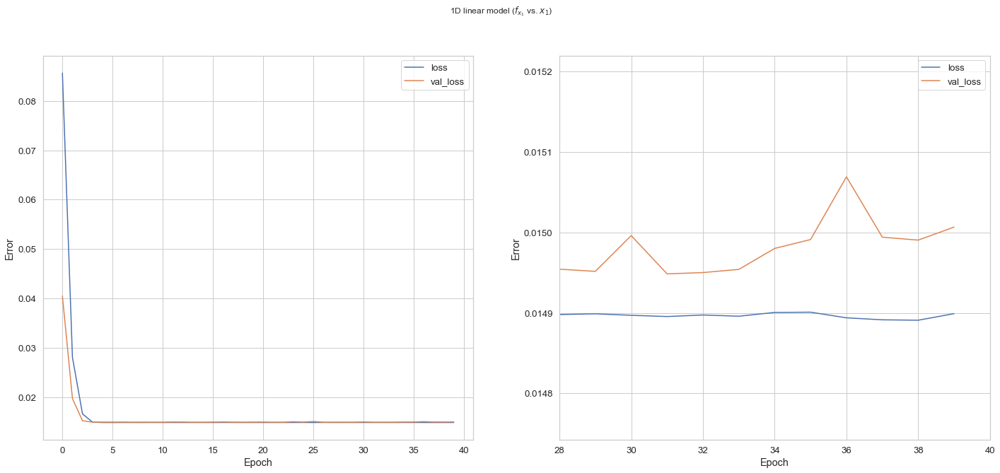

In [34]:
plot_loss(history_linear_x1, 'loss_linear_x1.pdf', '1D linear model ($f_{x_1}$ vs. $x_1$)')

In [35]:
# save model loss on test set for evaluation section below
test_results['linear_x1'] = linear_model_x1.evaluate(x1_test, fx1_test, verbose=0)

#### Plot predictions vs. true values

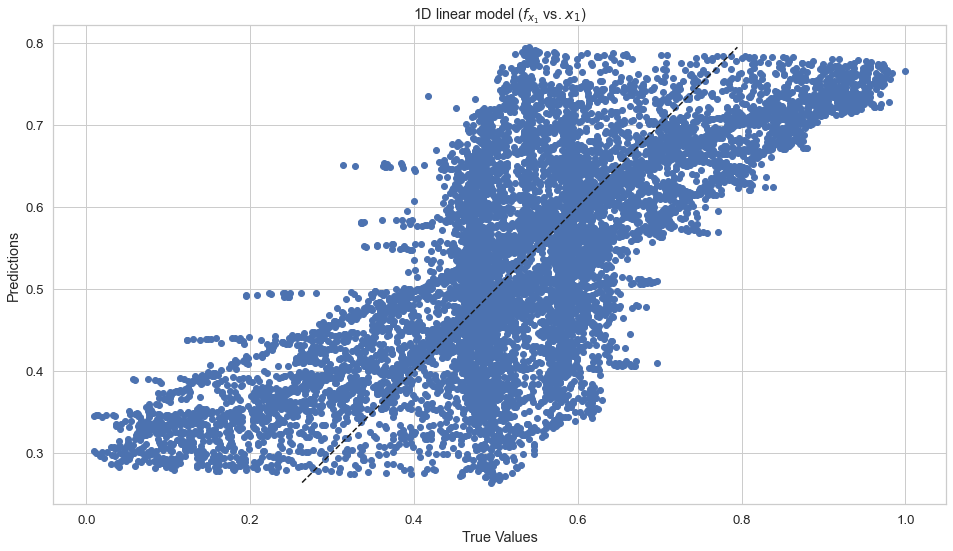

In [36]:
fx1_test_pred = linear_model_x1.predict(x1_test)
fig = plt.figure(figsize=(16,10))
ax = fig.add_subplot(111, aspect='equal')
ax.scatter(fx1_test, fx1_test_pred)
ax.plot([np.min(fx1_test_pred), np.max(fx1_test_pred)], [np.min(fx1_test_pred), np.max(fx1_test_pred)], linestyle='dashed', label='Predictions', color='k')
#ax.plot([0.2, 0.8], [0.2, 0.8], linestyle='dashed', label='Predictions', color='k')
ax.set_xlabel('True Values')
ax.set_ylabel('Predictions')
ax.set_title('1D linear model ($f_{x_1}$ vs. $x_1$)')
plt.savefig(output_dir/'pred_vs_true_linear_x1.pdf')

#### Plot $f_{x_1}$ vs. $x_1$ (scaled)

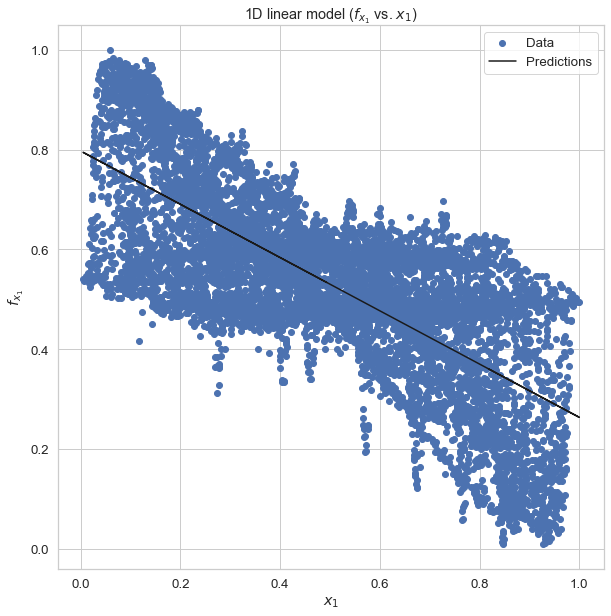

In [37]:
fig = plt.figure(figsize=(16,10))
ax = fig.add_subplot(111, aspect='equal')
ax.scatter(x1_test, fx1_test, label='Data')
ax.plot(x1_test, fx1_test_pred, label='Predictions', color='k')
ax.set_xlabel('$x_{1}$')
ax.set_ylabel('$f_{x{_1}}$')
ax.set_title('1D linear model ($f_{x_1}$ vs. $x_1$)')
ax.legend()
plt.savefig(output_dir/'linear_fx1_vs_x1.pdf')

### Predict all 6 forces from 12 input features

In [38]:
linear_model_12 = keras.experimental.LinearModel(units=6)
linear_model_12.compile(optimizer='adam', loss='mean_squared_error')
history_linear_12 = linear_model_12.fit(
    X_train_12, Y_train, 
    validation_data=(X_val_12, Y_val),
    batch_size = 32,
    epochs=200,
    verbose=0)
with open(output_dir/'history_linear_12.pickle', 'wb') as f:
    pickle.dump(history_linear_12.history, f)

#### Plot loss vs. epoch

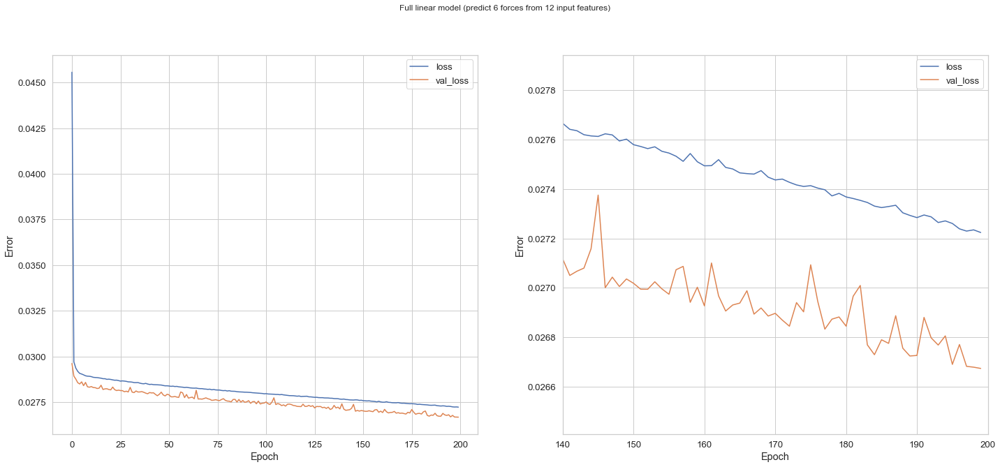

In [39]:
plot_loss(history_linear_12, 'loss_linear_12.pdf', 'Full linear model (predict 6 forces from 12 input features)')

In [40]:
# save model loss on test set for evaluation section below
test_results['linear_12'] = linear_model_12.evaluate(X_test_12, Y_test, verbose=0)

#### Plot predictions vs. true values

In [41]:
def plot_pred_vs_true(pred, true, name, titles=None):
    fig = plt.figure(figsize=(30,16))
    for i in range(len(pred.T)):
        ax = fig.add_subplot(2,3,i+1)
        ax.scatter(true.T[i], pred.T[i])
        ax.plot([np.min(pred), np.max(pred)],[np.min(pred), np.max(pred)], linestyle='dashed', linewidth=2, color='k')
        ax.set_xlabel('True Values')
        ax.set_ylabel('Predictions')
        if len(titles)>=len(pred.T):
            ax.set_title(titles[i])
    plt.savefig(output_dir/'pred_vs_true_{}.pdf'.format(name))

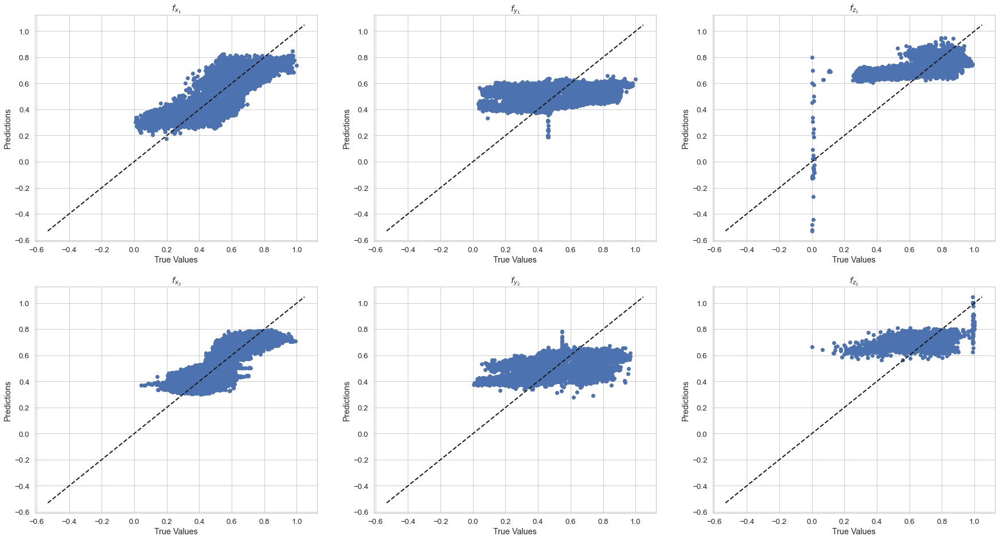

In [42]:
Y_test_pred_linear_12 = linear_model_12.predict(X_test_12)
plot_pred_vs_true(Y_test_pred_linear_12, Y_test, 'pred_vs_true_linear_12', titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## 4.2. DNN regression

I experimented by varying the number of layers, dropout rate, learning rate, batch size, and adding batch normalization layers—the model below achieves pretty good performance.

In [43]:
# The Sequential model will do just fine here 
# (functional API is more flexible though) 

def setup_dnn_model(n_outputs):
  model = keras.Sequential([
      #layers.BatchNormalization(),
      layers.Dense(100, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dense(n_outputs)
  ])

  model.compile(loss='mean_squared_error',
                optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3, decay=5e-6))
  return model

In [44]:
# dnn config
dnn_tag = "dnn_100x5_05dropout"
dnn_epochs = 1000
dnn_batch_size = 32

### Predict all 6 forces from 12 input features

In [45]:
dnn_model_12 = setup_dnn_model(Y_train.shape[-1])
dnn_model_12_tag = "{}_12features".format(dnn_tag)

In [46]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_12_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_12 = dnn_model_12.fit(
    X_train_12, Y_train,
    validation_data=(X_val_12, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch], 
    verbose=0
    )
dnn_model_12.summary()
with open(output_dir/'history_dnn_12.pickle', 'wb') as f:
    pickle.dump(history_dnn_12.history, f)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 100)               1300      
                                                                 
 dropout (Dropout)           (None, 100)               0         
                                                                 
 dense_1 (Dense)             (None, 100)               10100     
                                                                 
 dropout_1 (Dropout)         (None, 100)               0         
                                                                 
 dense_2 (Dense)             (None, 100)               10100     
                                                                 
 dropout_2 (Dropout)         (None, 100)               0         
                                                                 
 dense_3 (Dense)             (None, 100)               1

#### Save DNN model

In [47]:
dnn_model_12.save(output_dir/"{}_{}.h5".format(dnn_model_12_tag, timestamp))

#### Plot loss vs. epoch

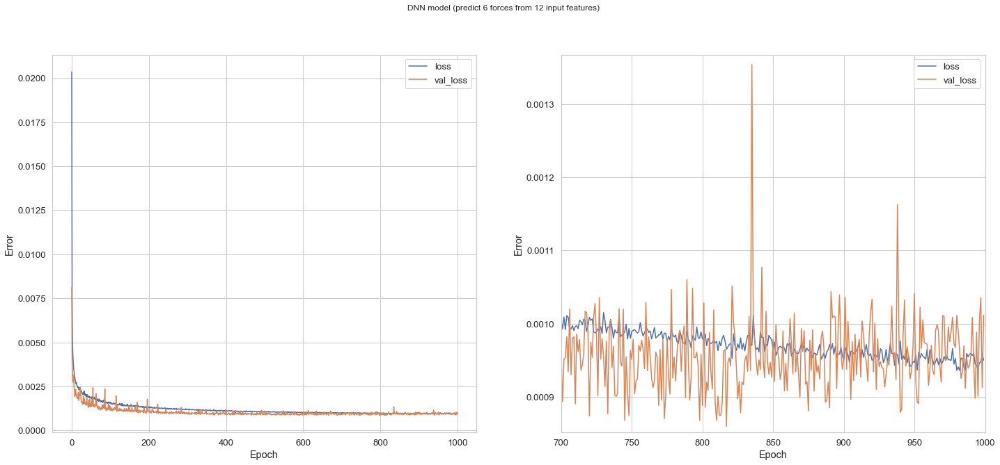

In [48]:
plot_loss(history_dnn_12, 'loss_{}.pdf'.format(dnn_model_12_tag), 'DNN model (predict 6 forces from 12 input features)')

In [49]:
# save model loss on test set for evaluation section below
test_results['dnn_12'] = dnn_model_12.evaluate(X_test_12, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

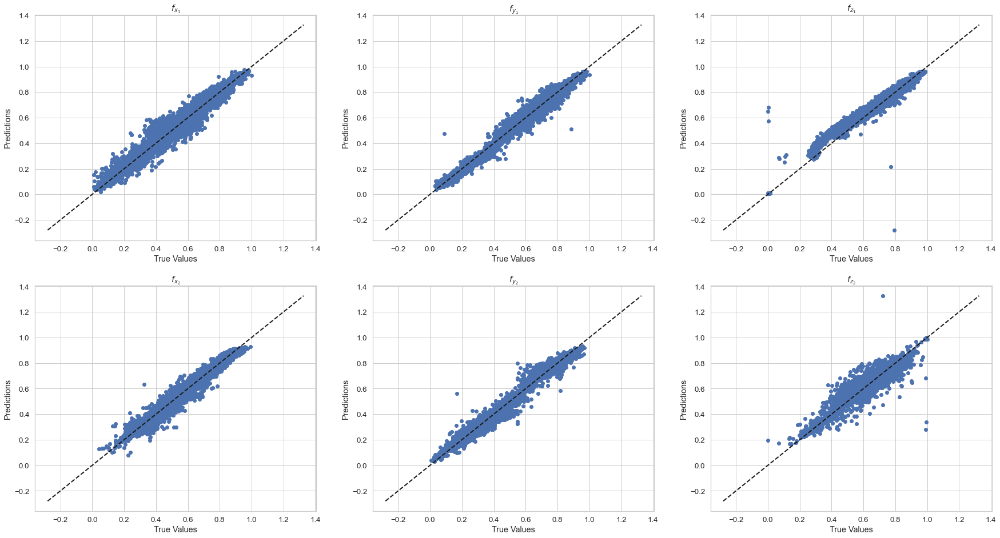

In [50]:
Y_test_pred_dnn_12 = dnn_model_12.predict(X_test_12)
plot_pred_vs_true(Y_test_pred_dnn_12, Y_test, 'pred_vs_true_{}'.format(dnn_model_12_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## Predict all 6 forces from 36 input features (12+2x12)

Up to 2nd order derivatives for 12 input features.

In [51]:
dnn_model_36 = setup_dnn_model(Y_train.shape[-1])
dnn_model_36_tag = "{}_36features".format(dnn_tag)

In [52]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_36_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_36 = dnn_model_36.fit(
    X_train_36, Y_train,
    validation_data=(X_val_36, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch],
    verbose=0
    )
dnn_model_36.summary()
with open(output_dir/'history_dnn_36.pickle', 'wb') as f:
    pickle.dump(history_dnn_36.history, f)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 100)               3700      
                                                                 
 dropout_4 (Dropout)         (None, 100)               0         
                                                                 
 dense_7 (Dense)             (None, 100)               10100     
                                                                 
 dropout_5 (Dropout)         (None, 100)               0         
                                                                 
 dense_8 (Dense)             (None, 100)               10100     
                                                                 
 dropout_6 (Dropout)         (None, 100)               0         
                                                                 
 dense_9 (Dense)             (None, 100)              

#### Save DNN model

In [53]:
dnn_model_36.save(output_dir/"{}_{}.h5".format(dnn_model_36_tag, timestamp))

#### Plot loss vs. epoch

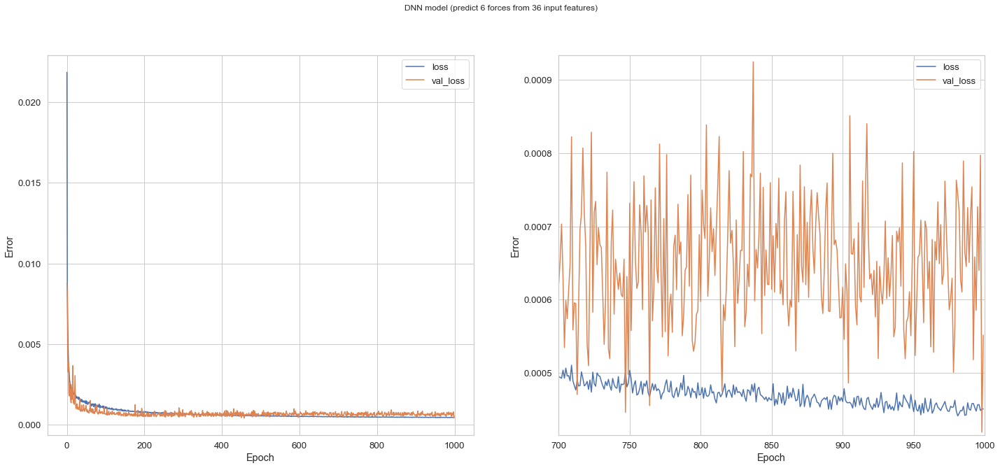

In [54]:
plot_loss(history_dnn_36, 'loss_{}.pdf'.format(dnn_model_36_tag), 'DNN model (predict 6 forces from 36 input features)')

In [55]:
# save model loss on test set for evaluation section below
test_results['dnn_36'] = dnn_model_36.evaluate(X_test_36, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

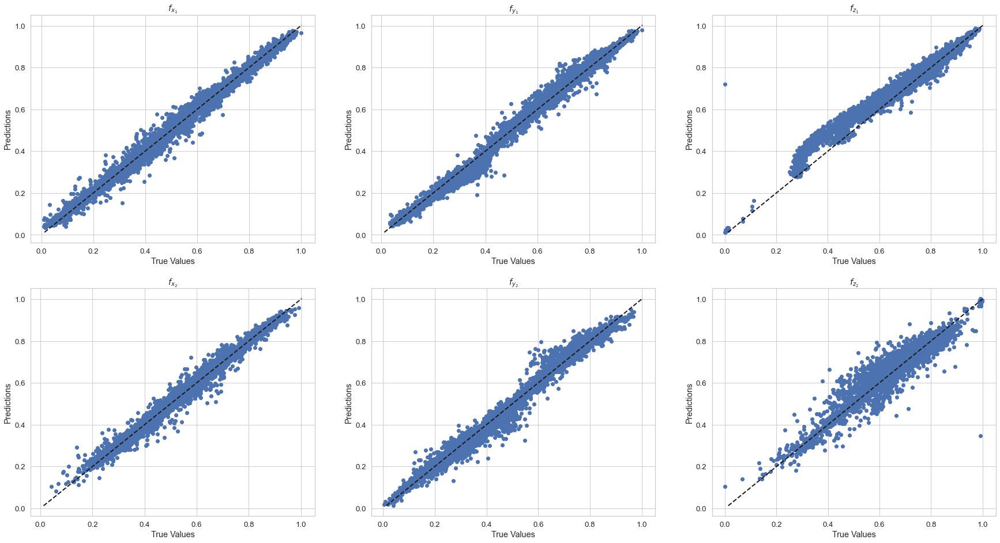

In [56]:
Y_test_pred_dnn_36 = dnn_model_36.predict(X_test_36)
plot_pred_vs_true(Y_test_pred_dnn_36, Y_test, 'pred_vs_true_{}'.format(dnn_model_36_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## Predict all 6 forces from 84 input features (12+6x12)
Up to 6th order derivatives for 12 input features.

In [57]:
dnn_model_84 = setup_dnn_model(Y_train.shape[-1])
dnn_model_84_tag = "{}_84features".format(dnn_tag)

In [58]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'dnn_84_tmp.h5', monitor='val_loss', save_freq='epoch')

history_dnn_84 = dnn_model_84.fit(
    X_train, Y_train,
    validation_data=(X_val, Y_val),
    batch_size = dnn_batch_size,
    epochs=dnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch],
    verbose=0
    )
dnn_model_84.summary()
with open(output_dir/'history_dnn_84.pickle', 'wb') as f:
    pickle.dump(history_dnn_84.history, f)

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_12 (Dense)            (None, 100)               8500      
                                                                 
 dropout_8 (Dropout)         (None, 100)               0         
                                                                 
 dense_13 (Dense)            (None, 100)               10100     
                                                                 
 dropout_9 (Dropout)         (None, 100)               0         
                                                                 
 dense_14 (Dense)            (None, 100)               10100     
                                                                 
 dropout_10 (Dropout)        (None, 100)               0         
                                                                 
 dense_15 (Dense)            (None, 100)              

#### Save DNN model

In [59]:
dnn_model_84.save(output_dir/"{}_{}.h5".format(dnn_model_84_tag, timestamp))

#### Plot loss vs. epoch

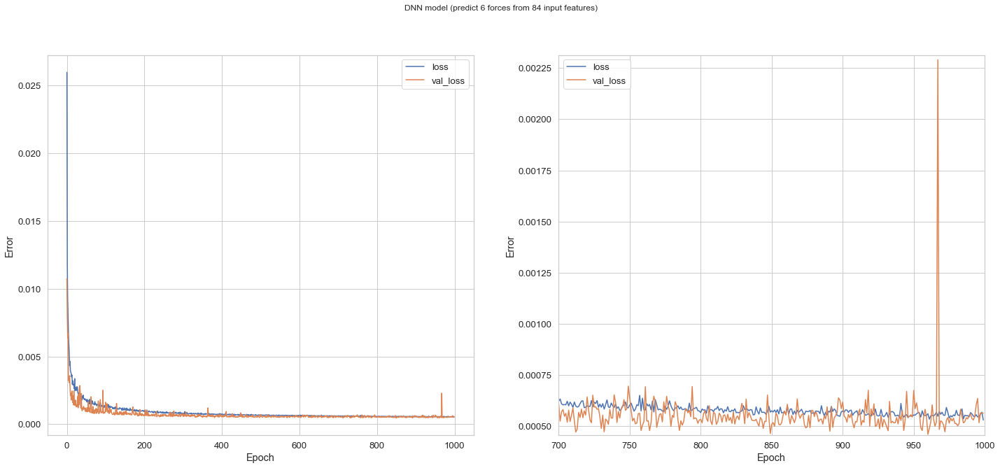

In [60]:
plot_loss(history_dnn_84, 'loss_{}.pdf'.format(dnn_model_84_tag), 'DNN model (predict 6 forces from 84 input features)')

In [61]:
# save model loss on test set for evaluation section below
test_results['dnn_84'] = dnn_model_84.evaluate(X_test, Y_test, verbose=0)

#### Compare prediction vs. true values for the test set

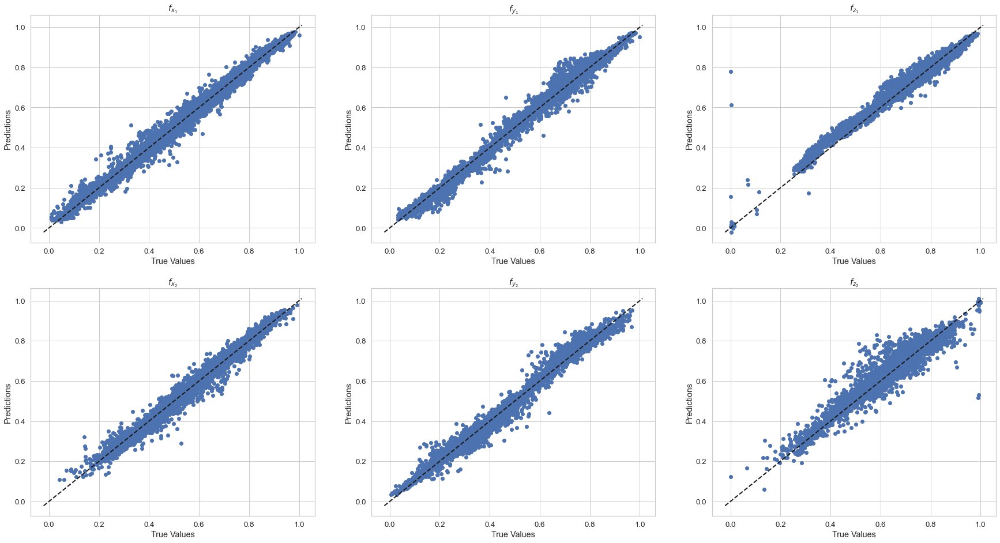

In [62]:
Y_test_pred_dnn_84 = dnn_model_84.predict(X_test)
plot_pred_vs_true(Y_test_pred_dnn_84, Y_test, 'pred_vs_true_{}'.format(dnn_model_84_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

## 4.3 RNN regression

I experimented with LSTM, GRU, and SimpleRNN layers. Performance was relatively similar, but the LSTM seemed to do slightly better. 

As is shown in section 5, an RNN did a significantly better job predicted unseen data than a DNN, especially for the dataset not seen during training.

In [63]:
def setup_rnn_model(n_outputs):
  model = keras.Sequential([
      #layers.BatchNormalization(),
      layers.LSTM(100, activation='relu', return_sequences=True),
      #layers.SimpleRNN(100, activation='relu', return_sequences=True),
      #layers.GRU(100, activation='relu', return_sequences=True),
      layers.Dropout(0.05),
      layers.LSTM(100, activation='relu', return_sequences=False),
      #layers.SimpleRNN(100, activation='relu', return_sequences=False),
      #layers.GRU(100, activation='relu', return_sequences=False),
      layers.Dropout(0.05),
      layers.Dense(100, activation='relu'),
      layers.Dense(n_outputs)
  ])

  model.compile(loss='mean_squared_error',
                optimizer=tf.keras.optimizers.Adam(learning_rate=1e-3, decay=5e-6))
  return model

In [64]:
# rnn config
rnn_tag = "rnn_lstm100x2_dense100x1_0p5drop" 
rnn_epochs = 300
rnn_batch_size = 32

In [65]:
rnn_model_12 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_12_tag = "{}_12features".format(rnn_tag)

In [66]:
rnn_model_36 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_36_tag = "{}_36features".format(rnn_tag)

In [67]:
rnn_model_84 = setup_rnn_model(Y_seq_train.shape[-1])
rnn_model_84_tag = "{}_84features".format(rnn_tag)

In [68]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_12_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_12 = rnn_model_12.fit(
    X_seq_train_12, Y_seq_train,
    validation_data=(X_seq_val_12, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch],
    verbose=0
    )
rnn_model_12.summary()
with open(output_dir/'history_rnn_12.pickle', 'wb') as f:
    pickle.dump(history_rnn_12.history, f)

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 20, 100)           45200     
                                                                 
 dropout_12 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_1 (LSTM)               (None, 100)               80400     
                                                                 
 dropout_13 (Dropout)        (None, 100)               0         
                                                                 
 dense_18 (Dense)            (None, 100)               10100     
                                                                 
 dense_19 (Dense)            (None, 6)                 606       
                                                                 
Total params: 136,306
Trainable params: 136,306
Non-tr

In [69]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_36_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_36 = rnn_model_36.fit(
    X_seq_train_36, Y_seq_train,
    validation_data=(X_seq_val_36, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch],
    verbose=0
    )
rnn_model_36.summary()
with open(output_dir/'history_rnn_36.pickle', 'wb') as f:
    pickle.dump(history_rnn_36.history, f)

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_2 (LSTM)               (None, 20, 100)           54800     
                                                                 
 dropout_14 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_3 (LSTM)               (None, 100)               80400     
                                                                 
 dropout_15 (Dropout)        (None, 100)               0         
                                                                 
 dense_20 (Dense)            (None, 100)               10100     
                                                                 
 dense_21 (Dense)            (None, 6)                 606       
                                                                 
Total params: 145,906
Trainable params: 145,906
Non-tr

In [70]:
%%time

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=20)
save_every_epoch = tf.keras.callbacks.ModelCheckpoint(output_dir/'rnn_84_tmp.h5', monitor='val_loss', save_freq='epoch')

history_rnn_84 = rnn_model_84.fit(
    X_seq_train, Y_seq_train,
    validation_data=(X_seq_val, Y_seq_val),
    batch_size = rnn_batch_size,
    epochs=rnn_epochs,
    callbacks=[save_every_epoch],
    #callbacks=[early_stop, save_every_epoch],
    verbose=0
    )
rnn_model_84.summary()
with open(output_dir/'history_rnn_84.pickle', 'wb') as f:
    pickle.dump(history_rnn_84.history, f)

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_4 (LSTM)               (None, 20, 100)           74000     
                                                                 
 dropout_16 (Dropout)        (None, 20, 100)           0         
                                                                 
 lstm_5 (LSTM)               (None, 100)               80400     
                                                                 
 dropout_17 (Dropout)        (None, 100)               0         
                                                                 
 dense_22 (Dense)            (None, 100)               10100     
                                                                 
 dense_23 (Dense)            (None, 6)                 606       
                                                                 
Total params: 165,106
Trainable params: 165,106
Non-tr

#### Save RNN model

In [71]:
rnn_model_12.save(output_dir/"{}_{}.h5".format(rnn_model_12_tag, timestamp), save_traces=False)

In [72]:
rnn_model_36.save(output_dir/"{}_{}.h5".format(rnn_model_36_tag, timestamp), save_traces=False)

In [73]:
rnn_model_84.save(output_dir/"{}_{}.h5".format(rnn_model_84_tag, timestamp), save_traces=False)

#### Plot loss vs. epoch

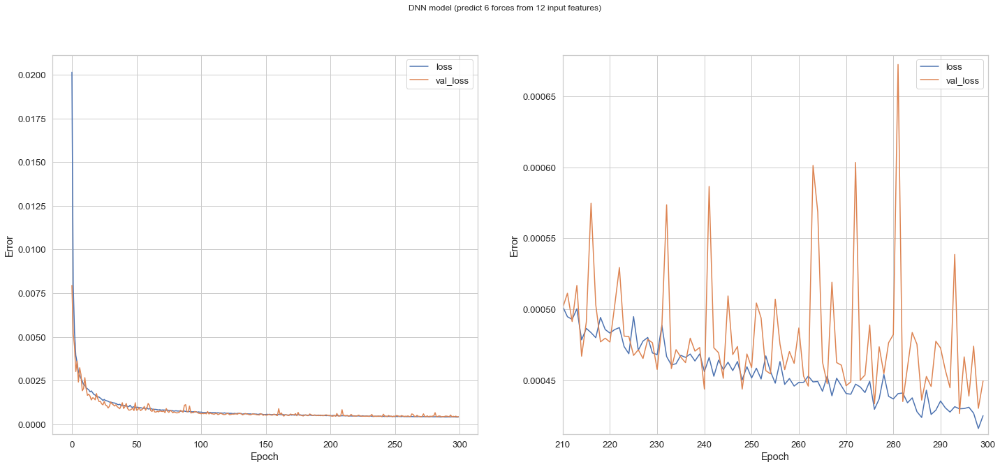

In [74]:
plot_loss(history_rnn_12, 'error_vs_epoch_{}.pdf'.format(rnn_model_12_tag), 'DNN model (predict 6 forces from 12 input features)')

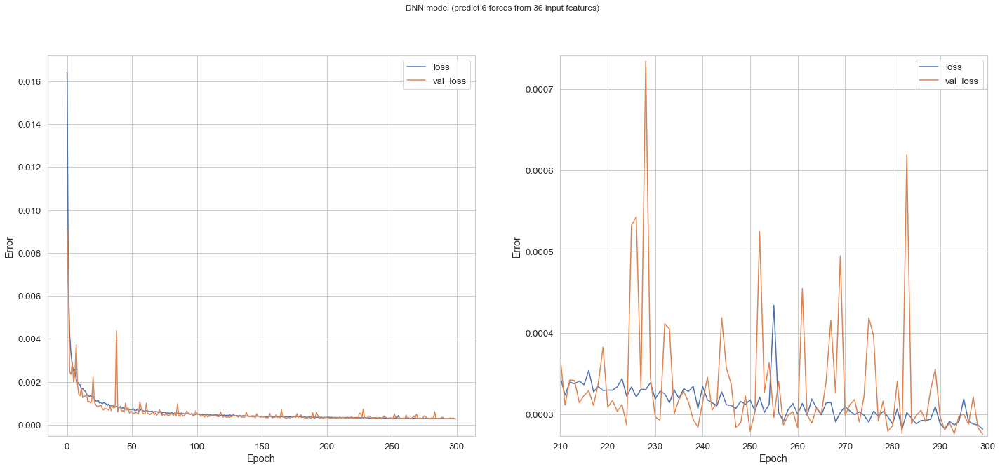

In [75]:
plot_loss(history_rnn_36, 'error_vs_epoch_{}.pdf'.format(rnn_model_36_tag), 'DNN model (predict 6 forces from 36 input features)')

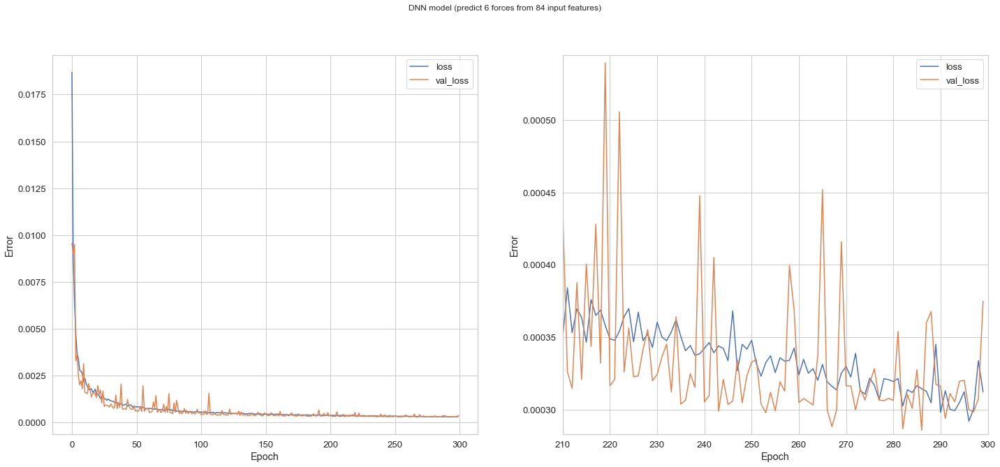

In [76]:
plot_loss(history_rnn_84, 'error_vs_epoch_{}.pdf'.format(rnn_model_84_tag), 'DNN model (predict 6 forces from 84 input features)')

In [77]:
# save model loss on test set for evaluation section below
test_results['rnn_12'] = rnn_model_12.evaluate(X_seq_test_12, Y_seq_test, verbose=0)

In [78]:
# save model loss on test set for evaluation section below
test_results['rnn_36'] = rnn_model_36.evaluate(X_seq_test_36, Y_seq_test, verbose=0)

In [79]:
# save model loss on test set for evaluation section below
test_results['rnn_84'] = rnn_model_84.evaluate(X_seq_test, Y_seq_test, verbose=0)

#### Compare prediction vs. true values for the test set

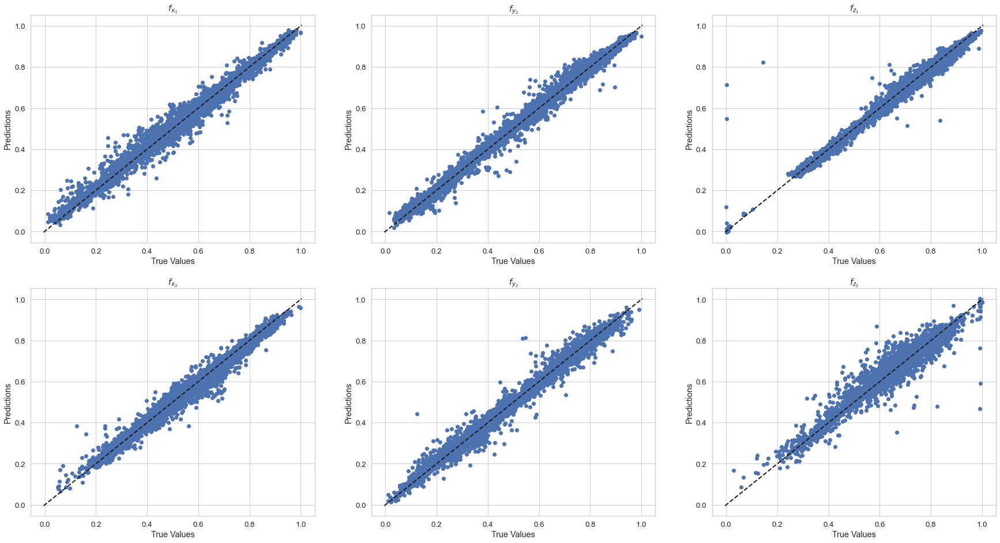

In [80]:
Y_seq_test_pred_12 = rnn_model_12.predict(X_seq_test_12)
plot_pred_vs_true(Y_seq_test_pred_12, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_12_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

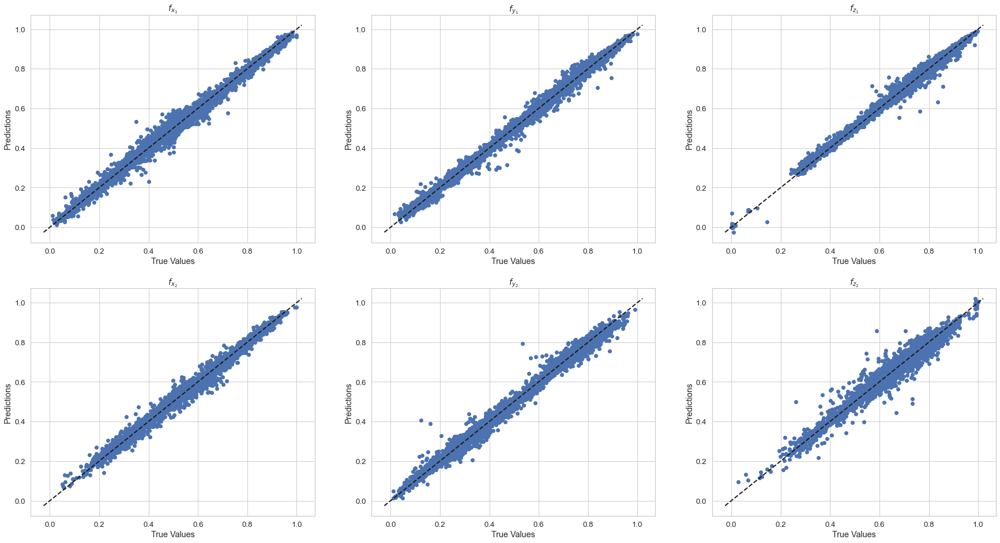

In [81]:
Y_seq_test_pred_36 = rnn_model_36.predict(X_seq_test_36)
plot_pred_vs_true(Y_seq_test_pred_36, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_36_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

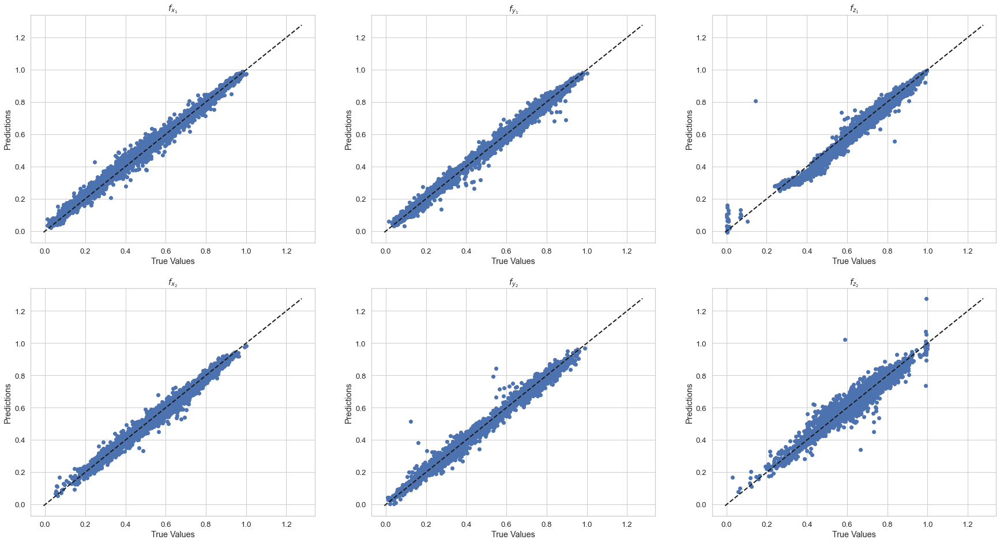

In [82]:
Y_seq_test_pred = rnn_model_84.predict(X_seq_test)
plot_pred_vs_true(Y_seq_test_pred, Y_seq_test, 'pred_vs_true_{}'.format(rnn_model_84_tag), titles = ['$f_{x_1}$','$f_{y_1}$','$f_{z_1}$','$f_{x_2}$','$f_{y_2}$','$f_{z_2}$'])

# 5. Evaluation

## 5.1 Loss on test sets

In [83]:
print("loss on test sets:")
for key,val in test_results.items():
    print("- {}: {:.2e}".format(key,val))

loss on test sets:
- linear_x1: 1.49e-02
- linear_12: 2.68e-02
- dnn_12: 1.13e-03
- dnn_36: 5.88e-04
- dnn_84: 5.49e-04
- rnn_12: 4.86e-04
- rnn_36: 2.67e-04
- rnn_84: 3.92e-04


Linear models:
- linear_x1: 1.47e-02
- linear_12: 2.69e-02

Loss after 1000 and 300 epochs for DNN and RNN respectively:

DNN:
- Run 1: DNN-200x3-100x2
    - dnn_12: 8.80e-04
    - dnn_36: 3.78e-04
    - dnn_84: 4.47e-04
- Run 2: DNN-100x5
    - dnn_12: 1.13e-03
    - dnn_36: 5.88e-04
    - dnn_84: 5.49e-04

RNN:
- Run 1: LSTM-100x2-DNN-100x1
    - rnn_12: 3.96e-04
    - rnn_36: 2.87e-04
    - rnn_84: 3.88e-04
- Run 2: same architecture 
    - rnn_12: 4.86e-04
    - rnn_36: 2.67e-04
    - rnn_84: 3.92e-04

### Loss on Test1, Test2, Test4 (no data from Test2 was included in the training)

In [84]:
def create_separate_test_sets(df, features, outputs, n_steps=20, feature_idx=None, dnn_model = None, rnn_model = None):

    # select relevant features and outputs
    X = df[features].to_numpy()
    Y = df[outputs].to_numpy()
    
    # apply scaling
    X_normed = scaler_x.transform(X)
    Y_normed = scaler_y.transform(Y)
    
    # handle sequences
    X_seq, Y_seq = split_sequences(X_normed, Y_normed, n_steps)
    

    # select indices corresponding to desired feature
    if feature_idx:
        X = X[:,feature_idx]
        X_normed = X_normed[:,feature_idx] 
        X_seq = X_seq[:,:,feature_idx]

    outputs = {
        'X': X, 'Y': Y, 
        'X_normed': X_normed, 'Y_normed': Y_normed,
        'X_seq_normed': X_seq, 'Y_seq_normed': Y_seq,
        'Y_seq': scaler_y.inverse_transform(Y_seq)
        }
    
    # calculate model predictions
    if dnn_model:
        Y_pred_normed = dnn_model.predict(X_normed)
        Y_pred = scaler_y.inverse_transform(Y_pred_normed)
        outputs['Y_pred_normed'] = Y_pred_normed
        outputs['Y_pred'] = Y_pred
    if rnn_model:
        Y_seq_pred_normed = rnn_model.predict(X_seq)
        outputs['Y_seq_pred_normed'] = Y_seq_pred_normed
        Y_seq_pred = scaler_y.inverse_transform(Y_seq_pred_normed)
        outputs['Y_seq_pred'] = Y_seq_pred
    
    return outputs


In [85]:
tests_12 = dict()
for i,df in enumerate(datasets):
    tests_12[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=feature_idx,
        dnn_model=dnn_model_12, rnn_model=rnn_model_12)


In [86]:
tests_36 = dict()
for i,df in enumerate(datasets):
    tests_36[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=feature_idx_2nd, 
        dnn_model=dnn_model_36, rnn_model=rnn_model_36)


In [87]:
tests_84 = dict()
for i,df in enumerate(datasets):
    tests_84[dataset_filenames[i]] = create_separate_test_sets(
        df, features_nth, outputs, n_steps, feature_idx=None,
        dnn_model=dnn_model_84, rnn_model=rnn_model_84)


In [88]:
print("Loss on full Test1, Test2, Test4 datasets:")
for filename in dataset_filenames:
    loss_dnn12 = dnn_model_12.evaluate(
        tests_12[filename]['X_normed'], tests_12[filename]['Y_normed'], verbose=0)
    loss_dnn36 = dnn_model_36.evaluate(
        tests_36[filename]['X_normed'], tests_36[filename]['Y_normed'], verbose=0)
    loss_dnn84 = dnn_model_84.evaluate(
        tests_84[filename]['X_normed'], tests_84[filename]['Y_normed'], verbose=0)
    loss_rnn12 = rnn_model_12.evaluate(
        tests_12[filename]['X_seq_normed'], tests_12[filename]['Y_seq_normed'], verbose=0)
    loss_rnn36 = rnn_model_36.evaluate(
        tests_36[filename]['X_seq_normed'], tests_36[filename]['Y_seq_normed'], verbose=0)
    loss_rnn84 = rnn_model_84.evaluate(
        tests_84[filename]['X_seq_normed'], tests_84[filename]['Y_seq_normed'], verbose=0)
    print("- {}:\n DNN-12: {:.2e}\n DNN-36: {:.2e}\n DNN-84: {:.2e}\n RNN-12: {:.2e}\n RNN-36: {:.2e}\n RNN-84: {:.2e}".format(
        filename, loss_dnn12, loss_dnn36, loss_dnn84, loss_rnn12, loss_rnn36, loss_rnn84))

Loss on full Test1, Test2, Test4 datasets:
- Test1:
 DNN-12: 7.80e-04
 DNN-36: 4.62e-04
 DNN-84: 3.34e-04
 RNN-12: 2.22e-04
 RNN-36: 1.33e-04
 RNN-84: 2.40e-04
- Test2:
 DNN-12: 7.63e-02
 DNN-36: 2.86e-02
 DNN-84: 3.39e-02
 RNN-12: 6.12e-02
 RNN-36: 2.79e-03
 RNN-84: 4.41e-03
- Test4:
 DNN-12: 1.08e-03
 DNN-36: 5.42e-04
 DNN-84: 5.86e-04
 RNN-12: 4.43e-04
 RNN-36: 2.43e-04
 RNN-84: 3.44e-04


### >> Note that no part of Test2 was included during training <<

**Observations:**
- The RNN does significantly better than any of the DNNs for all datasets. It has about an order of magnitude lower loss on Test2. 
- DNN/RNN-84 does a bit worse than DNN/RNN-36, indicating that adding higher-order derivatives beyond acceleration makes learning harder. It may also not be worth it adding the additional derivatives. Perhaps training for more epochs could help. 
- Comparing the loss on Test1 and Test4 (70 percent of Test1+Test4 was seen during training) w.r.t. loss on Test2, it is clear that all models struggled to generalize well to Test2. **There is room for improvement here.**

## 5.2. Prediction error


### Model predictions on the different test sets

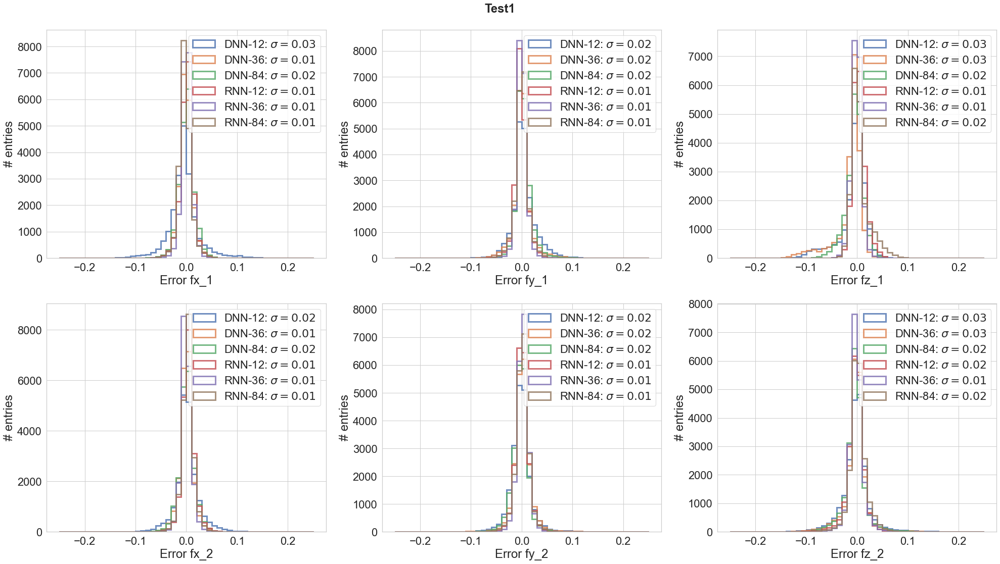

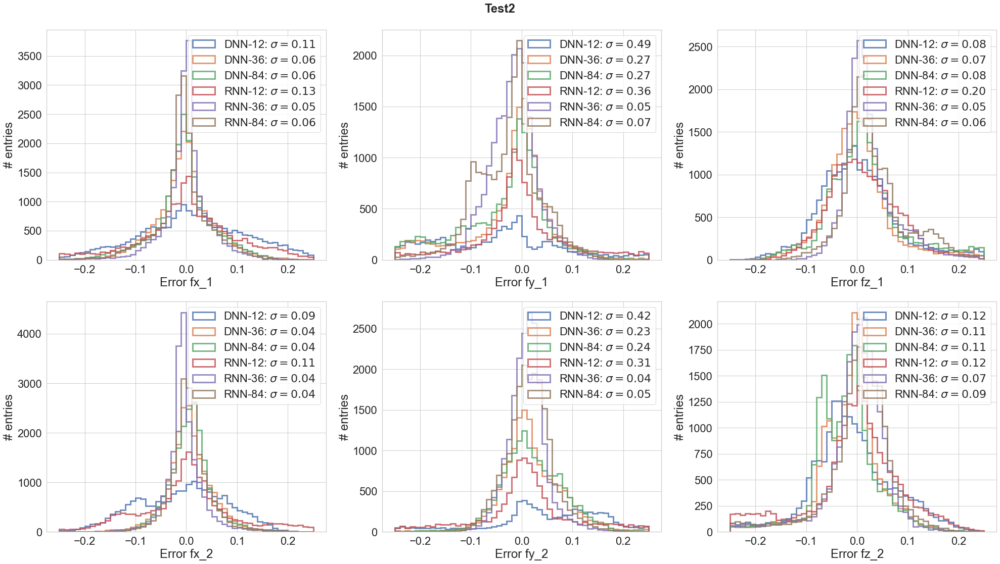

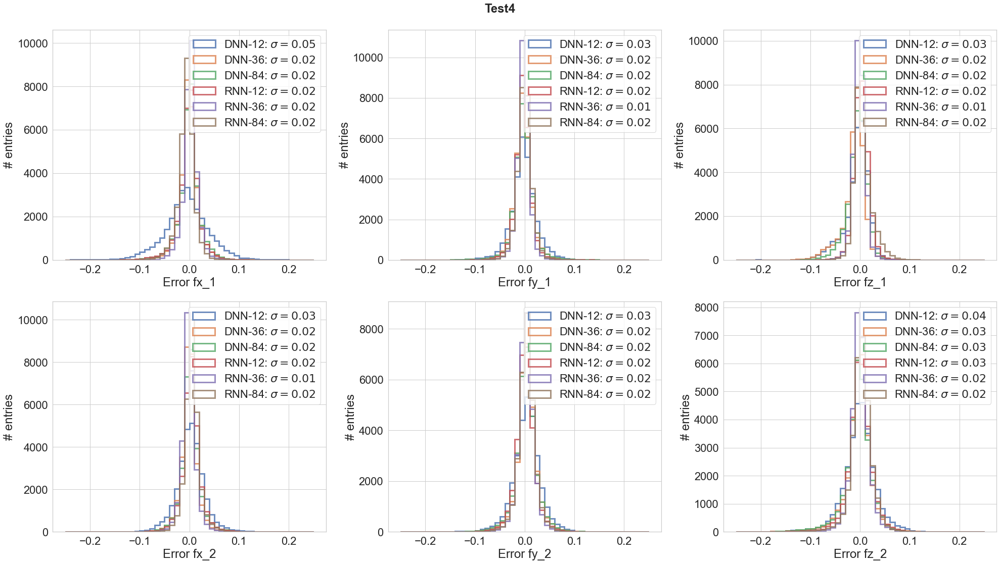

In [89]:
tmin = 0
tmax = -1
bins=50
linewidth=3

sns.set(font_scale = 2)
sns.color_palette()
sns.set_style("whitegrid")
for filename in dataset_filenames:

    Y_err_12 = tests_12[filename]['Y_normed'] - tests_12[filename]['Y_pred_normed']
    Y_err_36 = tests_36[filename]['Y_normed'] - tests_36[filename]['Y_pred_normed']
    Y_err_84 = tests_84[filename]['Y_normed'] - tests_84[filename]['Y_pred_normed']
    Y_seq_err_12 = tests_12[filename]['Y_seq_normed'] - tests_12[filename]['Y_seq_pred_normed']
    Y_seq_err_36 = tests_36[filename]['Y_seq_normed'] - tests_36[filename]['Y_seq_pred_normed']
    Y_seq_err_84 = tests_84[filename]['Y_seq_normed'] - tests_84[filename]['Y_seq_pred_normed']

    fig = plt.figure(figsize=(28,16))
    fig.suptitle(filename, weight='bold').set_fontsize('24')
    for i in range(len(outputs)):

        label_dnn12 = "DNN-12: $\sigma={:.2f}$".format(np.std(Y_err_12[:,i]))
        label_dnn36 = "DNN-36: $\sigma={:.2f}$".format(np.std(Y_err_36[:,i]))
        label_dnn84 = "DNN-84: $\sigma={:.2f}$".format(np.std(Y_err_84[:,i]))
        label_rnn12 = "RNN-12: $\sigma={:.2f}$".format(np.std(Y_seq_err_12[:,i]))
        label_rnn36 = "RNN-36: $\sigma={:.2f}$".format(np.std(Y_seq_err_36[:,i]))
        label_rnn84 = "RNN-84: $\sigma={:.2f}$".format(np.std(Y_seq_err_84[:,i]))

        ax = fig.add_subplot(2,3,i+1)
        ax.hist(Y_err_12[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn12)
        ax.hist(Y_err_36[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn36)
        ax.hist(Y_err_84[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_dnn84)
        ax.hist(Y_seq_err_12[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn12)
        ax.hist(Y_seq_err_36[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn36)
        ax.hist(Y_seq_err_84[:,i], bins=bins, range=(-0.25, 0.25), alpha=0.8, histtype='step', linewidth=linewidth, label=label_rnn84)
        ax.set_xlabel('Error {}'.format(outputs[i]))
        ax.set_ylabel('# entries')
        ax.legend()
    plt.tight_layout()
    plt.savefig(output_dir/'{}_error.pdf'.format(filename))

**Observations:**
- The RNN models outperforms the DNN models. 
- The error is low (1-2% for RNN-36/84) on Test1 and Test4 (70% of Test1+Test4 was seen during training). 
- The error is significantly higher (4-10%) for RNN-36/84 on Test2 (not seen during training).

### R2 score

In [90]:
from sklearn.metrics import r2_score

print("R2 score on Test1, Test2, Test4 datasets:")
print("(" + " ".join(outputs) + ")")
for filename in dataset_filenames:
 
    r2_dnn12 = ['DNN-12:']
    r2_dnn36 = ['DNN-36:']
    r2_dnn84 = ['DNN-84:']
    r2_rnn12 = ['RNN-12:']
    r2_rnn36 = ['RNN-36:']
    r2_rnn84 = ['RNN-84:']
    for i in range(len(outputs)):
        r2_dnn12.append("{:.2f}".format(r2_score(tests_12[filename]['Y_normed'][:,i], tests_12[filename]['Y_pred_normed'][:,i])))
        r2_dnn36.append("{:.2f}".format(r2_score(tests_36[filename]['Y_normed'][:,i], tests_36[filename]['Y_pred_normed'][:,i])))
        r2_dnn84.append("{:.2f}".format(r2_score(tests_84[filename]['Y_normed'][:,i], tests_84[filename]['Y_pred_normed'][:,i])))
        r2_rnn12.append("{:.2f}".format(r2_score(tests_12[filename]['Y_seq_normed'][:,i], tests_12[filename]['Y_seq_pred_normed'][:,i])))
        r2_rnn36.append("{:.2f}".format(r2_score(tests_36[filename]['Y_seq_normed'][:,i], tests_36[filename]['Y_seq_pred_normed'][:,i])))
        r2_rnn84.append("{:.2f}".format(r2_score(tests_84[filename]['Y_seq_normed'][:,i], tests_84[filename]['Y_seq_pred_normed'][:,i])))

    print("- {}:".format(filename))
    print("\t"+"\t".join(r2_dnn12))
    print("\t"+"\t".join(r2_dnn36))
    print("\t"+"\t".join(r2_dnn84))
    print("\t"+"\t".join(r2_rnn12))
    print("\t"+"\t".join(r2_rnn36))
    print("\t"+"\t".join(r2_rnn84))

R2 score on Test1, Test2, Test4 datasets:
(fx_1 fy_1 fz_1 fx_2 fy_2 fz_2)
- Test1:
	DNN-12:	0.97	0.99	0.97	0.98	0.99	0.94
	DNN-36:	0.99	1.00	0.96	0.99	0.99	0.96
	DNN-84:	0.99	1.00	0.98	0.99	1.00	0.97
	RNN-12:	0.99	1.00	0.99	0.99	1.00	0.98
	RNN-36:	1.00	1.00	1.00	1.00	1.00	0.99
	RNN-84:	0.99	1.00	0.98	0.99	1.00	0.98
- Test2:
	DNN-12:	0.57	-2.08	0.70	0.61	-2.13	-0.05
	DNN-36:	0.88	-0.09	0.78	0.90	-0.12	0.06
	DNN-84:	0.87	-0.32	0.67	0.91	-0.30	-0.09
	RNN-12:	0.46	-1.08	-1.13	0.45	-1.10	-0.11
	RNN-36:	0.92	0.97	0.85	0.93	0.97	0.61
	RNN-84:	0.89	0.94	0.75	0.91	0.96	0.35
- Test4:
	DNN-12:	0.94	0.99	0.97	0.96	0.98	0.85
	DNN-36:	0.99	0.99	0.97	0.98	0.99	0.89
	DNN-84:	0.98	0.99	0.98	0.98	0.99	0.88
	RNN-12:	0.99	0.99	0.99	0.98	0.99	0.92
	RNN-36:	0.99	1.00	0.99	0.99	0.99	0.95
	RNN-84:	0.99	1.00	0.98	0.99	0.99	0.94


The coefficient of determination (R2) is the proportion of the variation in the dependent variable (e.g., predicted forces) that is predictable from the independent variables (e.g., measured forces). The range is from negative infinity to +1. 
- An R2 score of +1 indicates that the predictions match the observations perfectly. 
- An R2 score of 0 indicates that the predictions are as good as random guesses around the mean of the observations.
- Negative R2 indicates that the predictions are worse than random. 

**Observations:**
- All models do pretty well on Test1 and Test4, of which a significant fraction (70%) was seen during training.
- The RNN models does significantly better on Test2, which was not seen during training.
- Although it did better than the DNN models, even the RNN struggled to predict forces in the $z$-direction on the Test2 dataset (especially for R2). 

### Pearson corrrelation coefficient

In [91]:
def pearson(x, y):
   corr = np.corrcoef(x, y)
   return corr[0,1]

In [92]:
print("Pearson correlations for Test1, Test2, Test4 datasets:")
print("(" + " ".join(outputs) + ")")
for filename in dataset_filenames:
 
    pearson_dnn12 = ['DNN-12:']
    pearson_dnn36 = ['DNN-36:']
    pearson_dnn84 = ['DNN-84:']
    pearson_rnn12 = ['RNN-12:']
    pearson_rnn36 = ['RNN-36:']
    pearson_rnn84 = ['RNN-84:']
    for i in range(len(outputs)):
        pearson_dnn12.append("{:.2f}".format(pearson(tests_12[filename]['Y_normed'][:,i], tests_12[filename]['Y_pred_normed'][:,i])))
        pearson_dnn36.append("{:.2f}".format(pearson(tests_36[filename]['Y_normed'][:,i], tests_36[filename]['Y_pred_normed'][:,i])))
        pearson_dnn84.append("{:.2f}".format(pearson(tests_84[filename]['Y_normed'][:,i], tests_84[filename]['Y_pred_normed'][:,i])))
        pearson_rnn12.append("{:.2f}".format(pearson(tests_12[filename]['Y_seq_normed'][:,i], tests_12[filename]['Y_seq_pred_normed'][:,i])))
        pearson_rnn36.append("{:.2f}".format(pearson(tests_36[filename]['Y_seq_normed'][:,i], tests_36[filename]['Y_seq_pred_normed'][:,i])))
        pearson_rnn84.append("{:.2f}".format(pearson(tests_84[filename]['Y_seq_normed'][:,i], tests_84[filename]['Y_seq_pred_normed'][:,i])))

    print("- {}:".format(filename))
    print("\t"+"\t".join(pearson_dnn12))
    print("\t"+"\t".join(pearson_dnn36))
    print("\t"+"\t".join(pearson_dnn84))
    print("\t"+"\t".join(pearson_rnn12))
    print("\t"+"\t".join(pearson_rnn36))
    print("\t"+"\t".join(pearson_rnn84))

Pearson correlations for Test1, Test2, Test4 datasets:
(fx_1 fy_1 fz_1 fx_2 fy_2 fz_2)
- Test1:
	DNN-12:	0.98	1.00	0.99	0.99	1.00	0.97
	DNN-36:	1.00	1.00	0.99	1.00	1.00	0.98
	DNN-84:	1.00	1.00	0.99	1.00	1.00	0.98
	RNN-12:	1.00	1.00	1.00	1.00	1.00	0.99
	RNN-36:	1.00	1.00	1.00	1.00	1.00	0.99
	RNN-84:	1.00	1.00	0.99	1.00	1.00	0.99
- Test2:
	DNN-12:	0.78	-0.57	0.85	0.79	-0.60	0.29
	DNN-36:	0.94	0.49	0.89	0.95	0.47	0.45
	DNN-84:	0.94	0.44	0.85	0.95	0.42	0.40
	RNN-12:	0.68	-0.11	0.52	0.67	-0.11	0.35
	RNN-36:	0.96	0.98	0.94	0.96	0.99	0.79
	RNN-84:	0.95	0.97	0.91	0.96	0.98	0.61
- Test4:
	DNN-12:	0.97	0.99	0.99	0.98	0.99	0.92
	DNN-36:	0.99	1.00	0.99	0.99	1.00	0.95
	DNN-84:	0.99	1.00	0.99	0.99	0.99	0.94
	RNN-12:	0.99	1.00	0.99	0.99	1.00	0.96
	RNN-36:	1.00	1.00	1.00	0.99	1.00	0.98
	RNN-84:	1.00	1.00	0.99	0.99	1.00	0.97


The Pearson correlation coefficient ($r$) can range from -1 to +1. 
- An $r$ of -1 indicates a perfect negative linear correlation.
- An $r$ of 0 indicates no correlation.
- An $r$ of +1 indicates a perfect positive linear correlation.

**Observations:**
- Similar to the observations for the R2 score. 

## 5.3. Time series plots of prediction vs. ground truth

In [93]:
def plot_timeseries(tmin = 12000, tmax = 12500, linewidth=4):
    
    t = np.linspace(tmin, tmax, tmax-tmin)
    sns.set(font_scale = 2)
    sns.color_palette()
    sns.set_style("whitegrid")
    for filename in dataset_filenames:

        fig = plt.figure(figsize=(30,30))
        fig.suptitle(filename, weight='bold').set_fontsize('24')
        for i in range(6):
            ax = fig.add_subplot(6, 1, i+1)
            ax.plot(t, tests_12[filename]['Y'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='Data', linestyle='dashed', linewidth=linewidth, color='k')
            ax.plot(t, tests_12[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-12 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_36[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-36 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_84[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-84 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_12[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-12 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.plot(t, tests_36[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-36 pred.', linestyle='dashed', linewidth=linewidth, color='red')
            ax.plot(t, tests_84[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-84 pred.', linestyle='dashed', linewidth=linewidth-2)
            ax.set_xlabel('t')
            ax.set_ylabel(outputs[i])
            ax.legend(loc=2)
        plt.tight_layout()
        plt.savefig(output_dir/'{}_timeseries_t{}to{}.pdf'.format(filename, tmin, tmax))

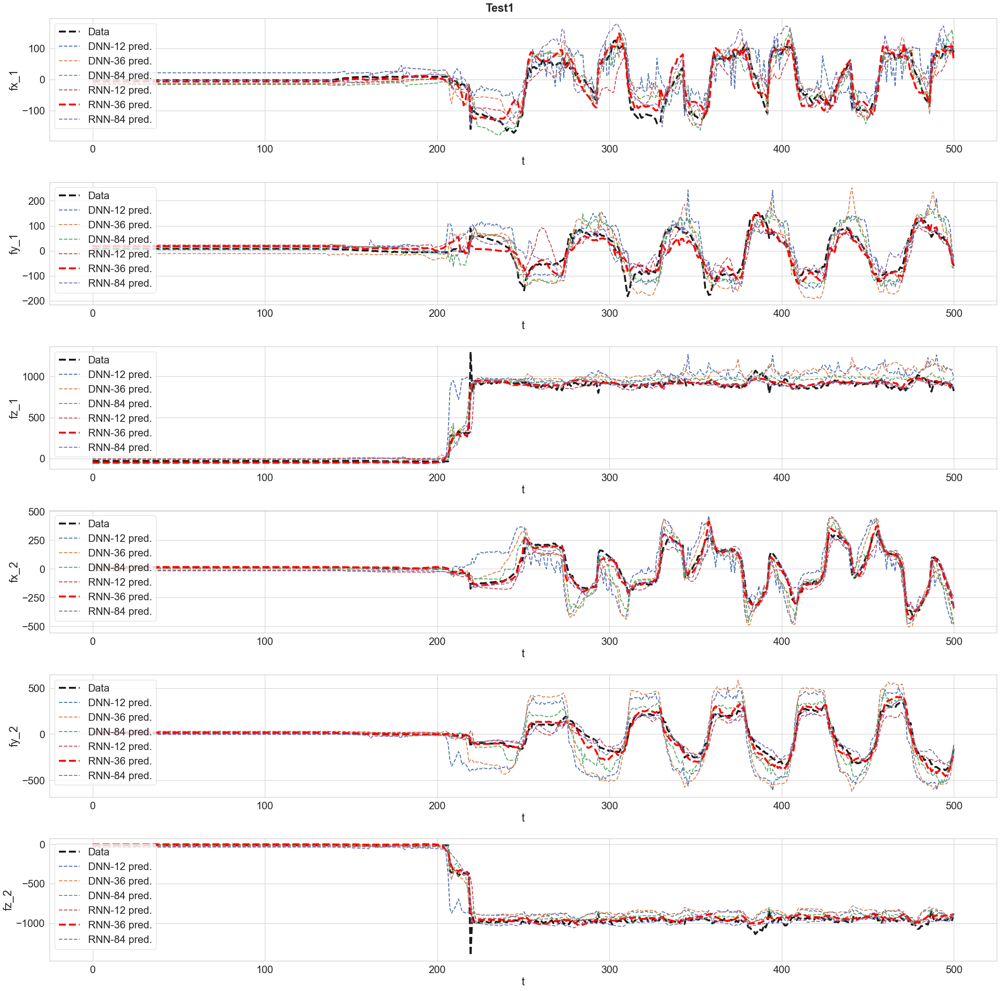

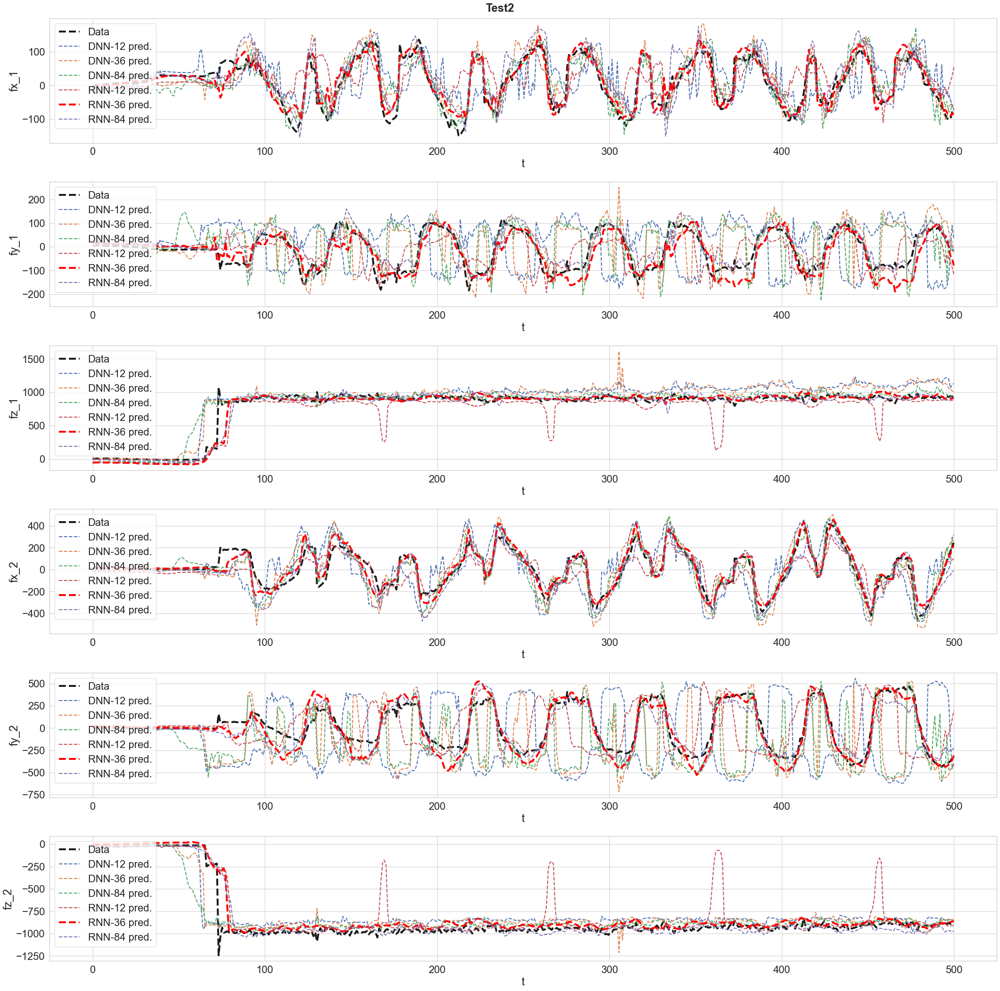

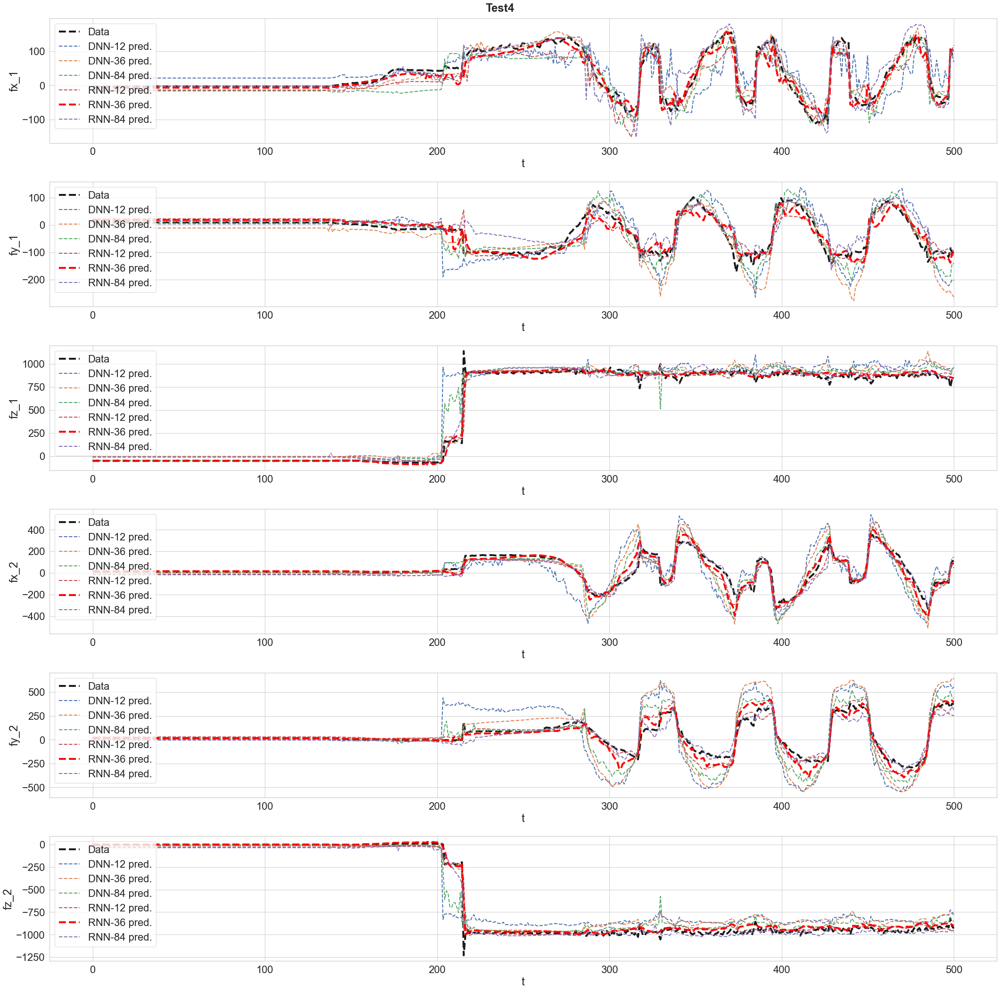

In [94]:
plot_timeseries(tmin=0, tmax=500)

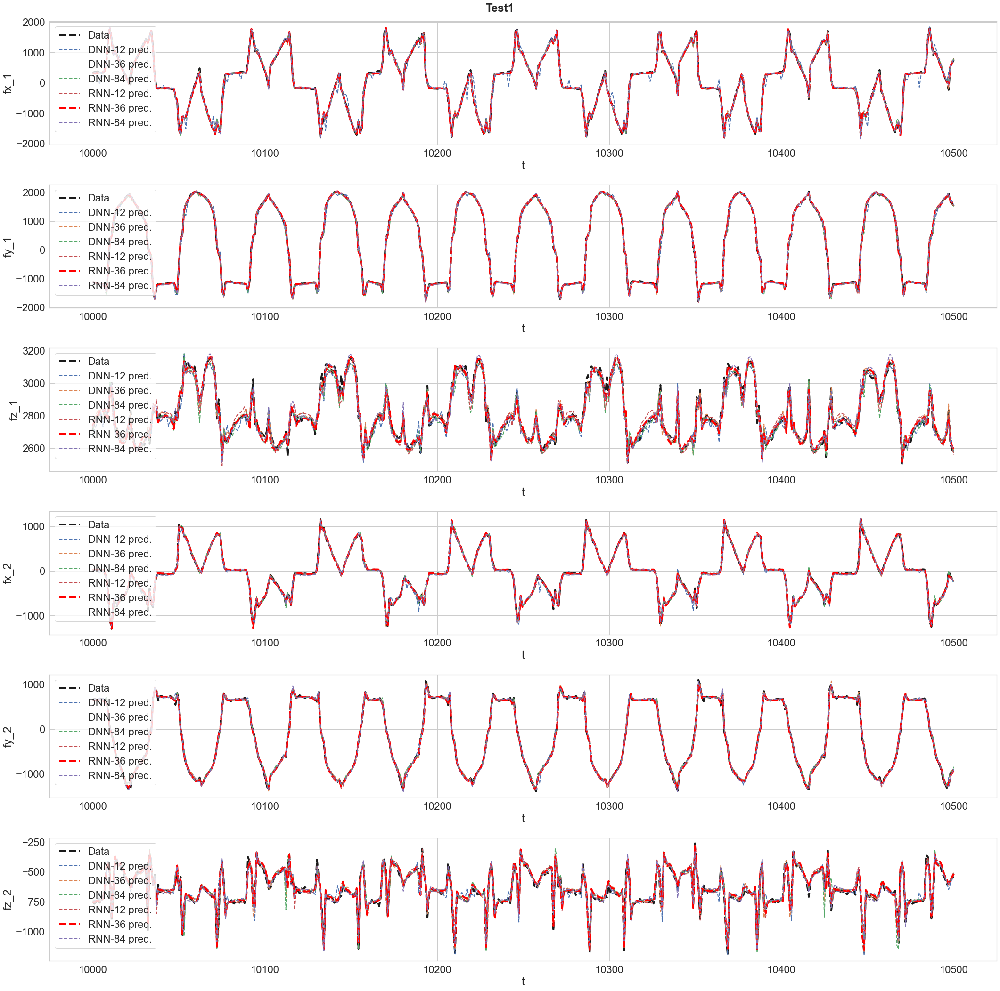

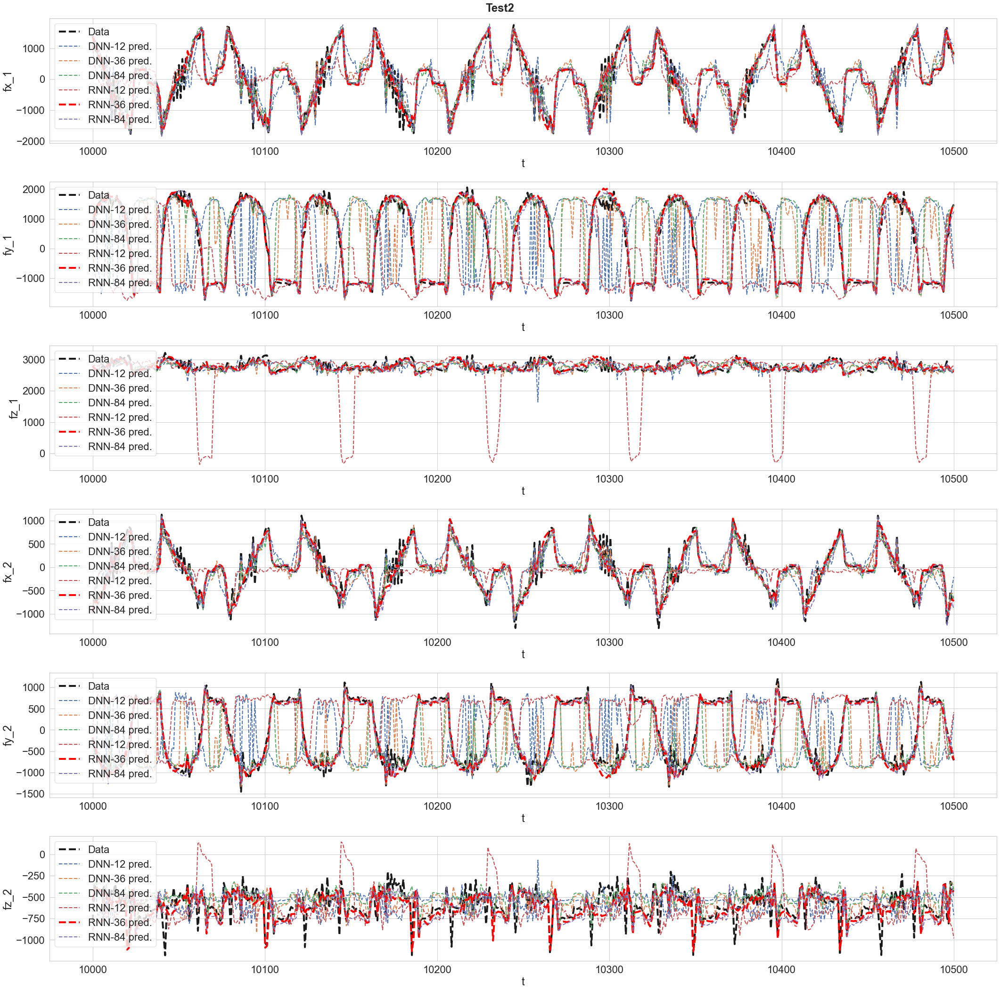

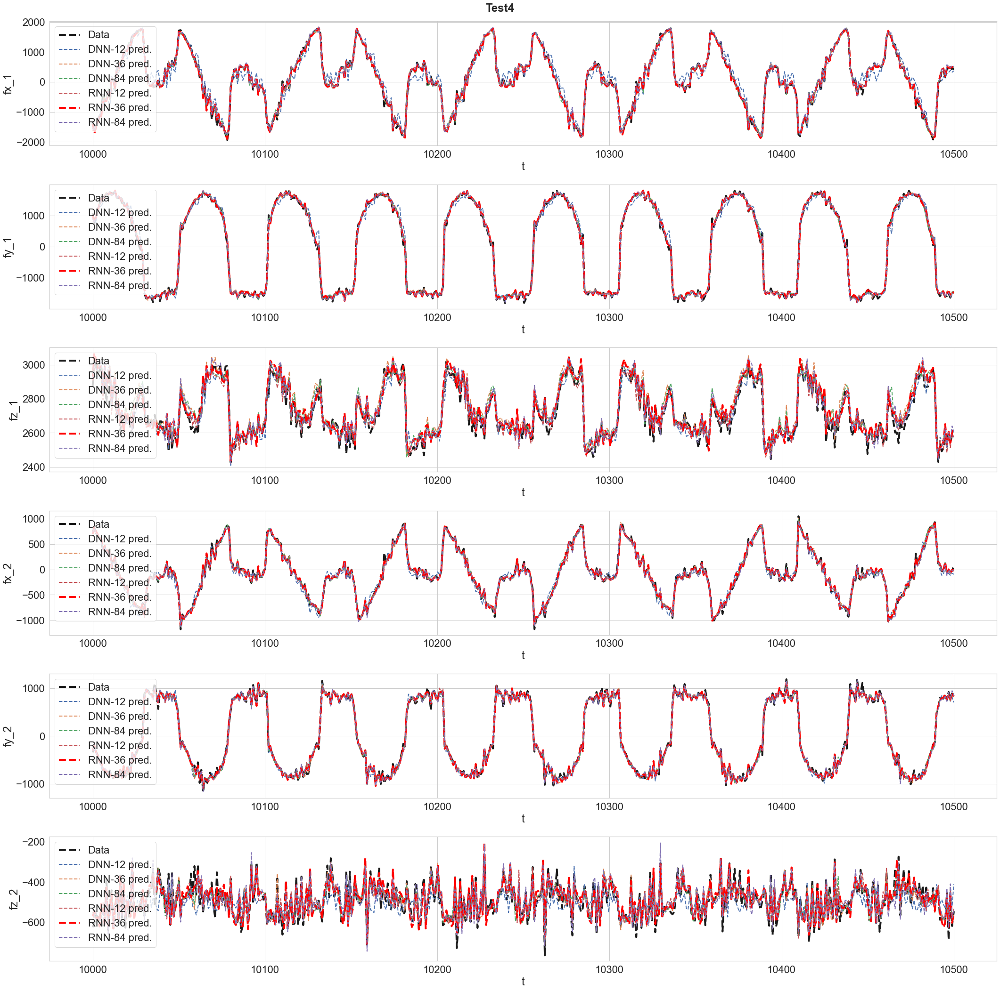

In [95]:
plot_timeseries(tmin=10000, tmax=10500)

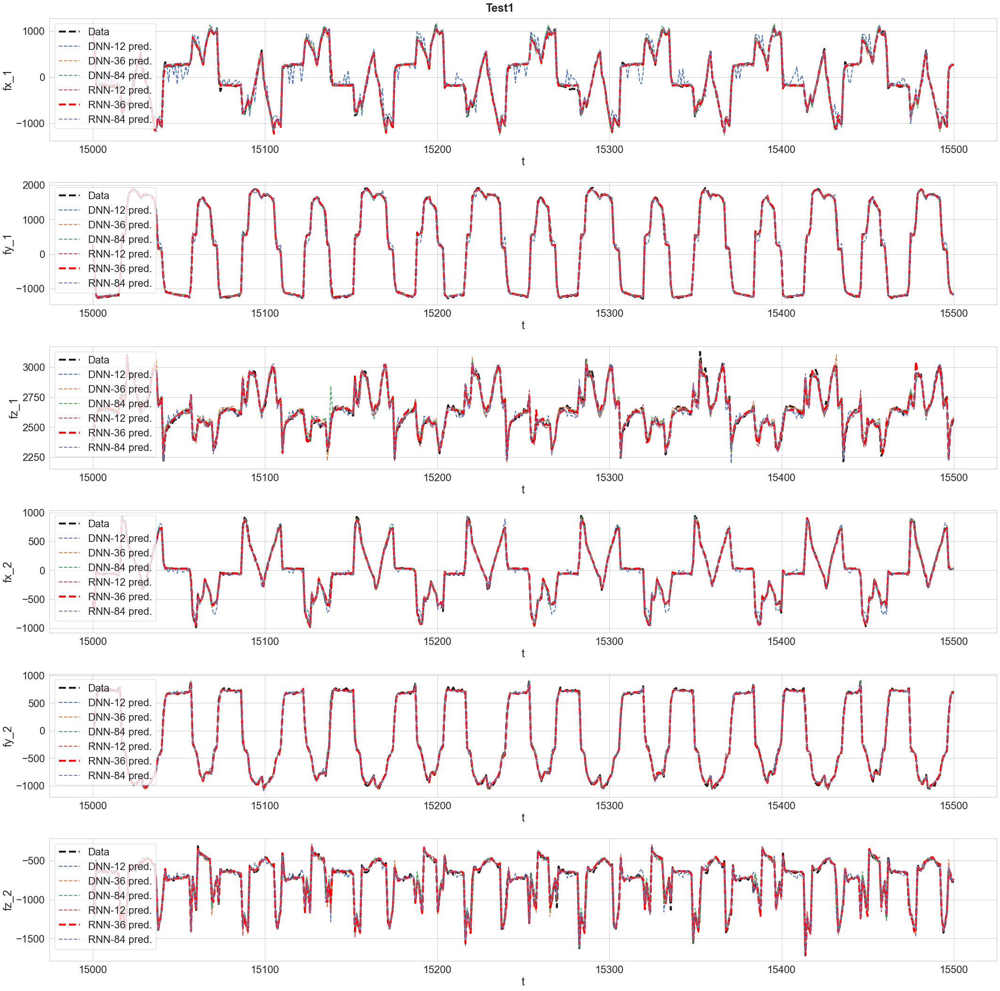

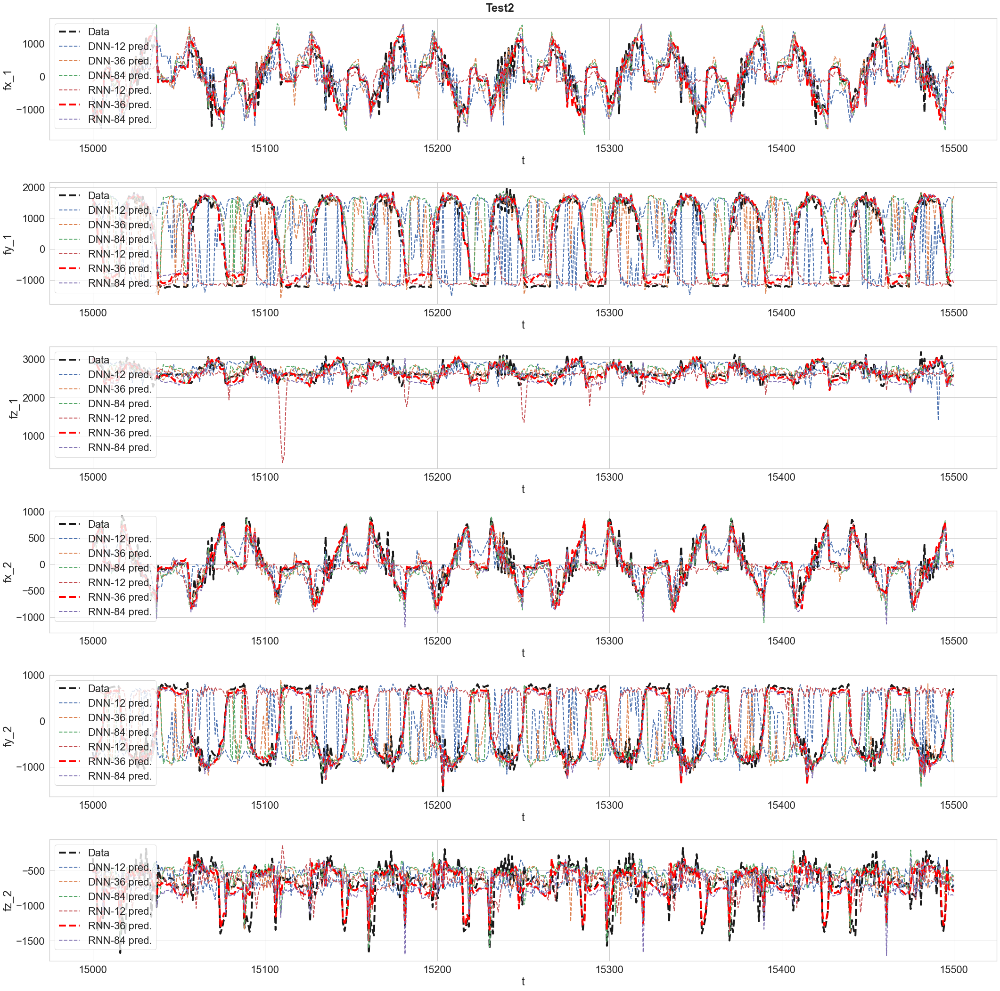

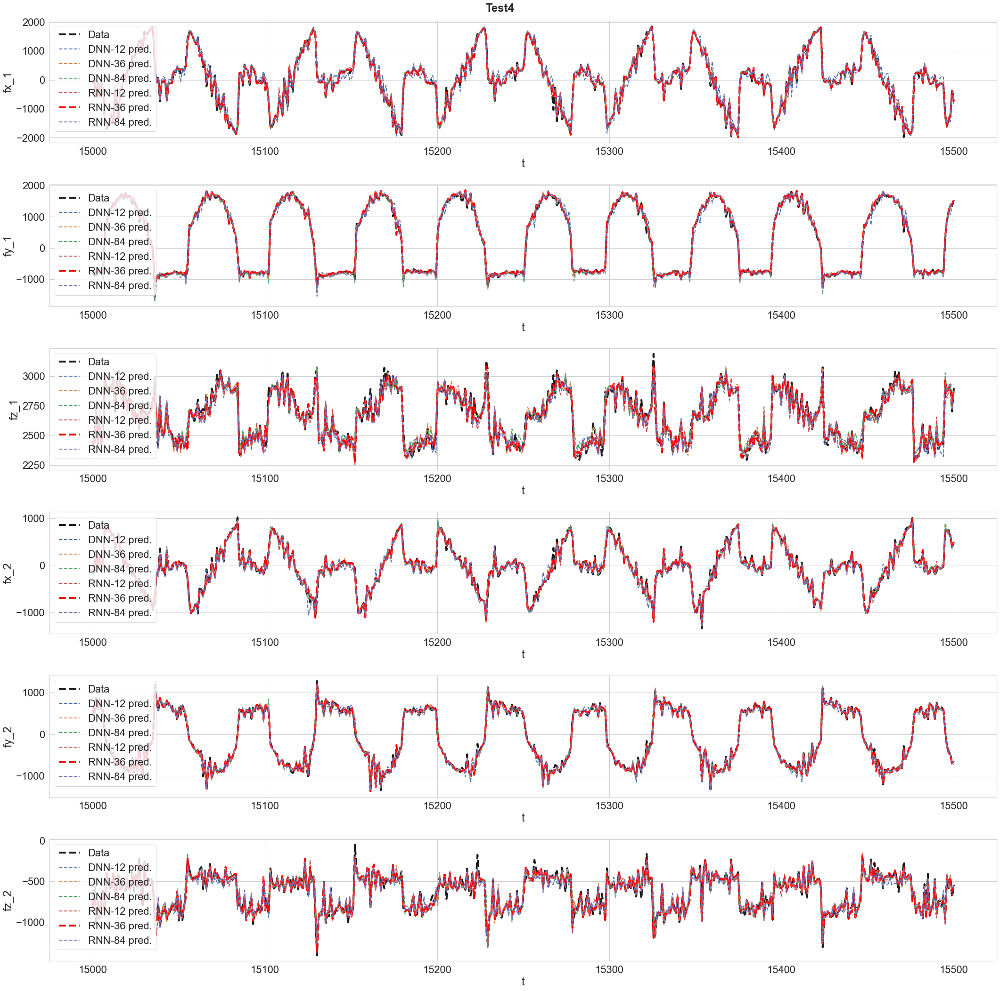

In [96]:
plot_timeseries(tmin=15000, tmax=15500)

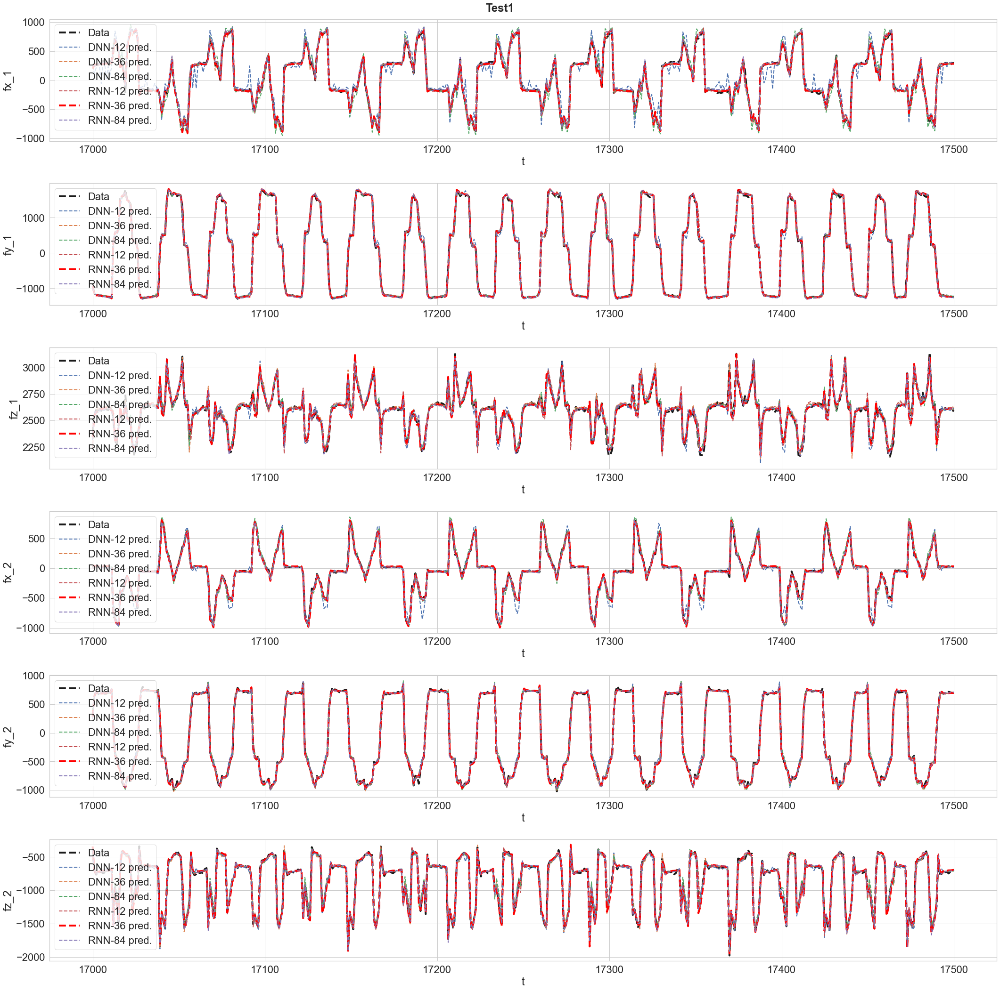

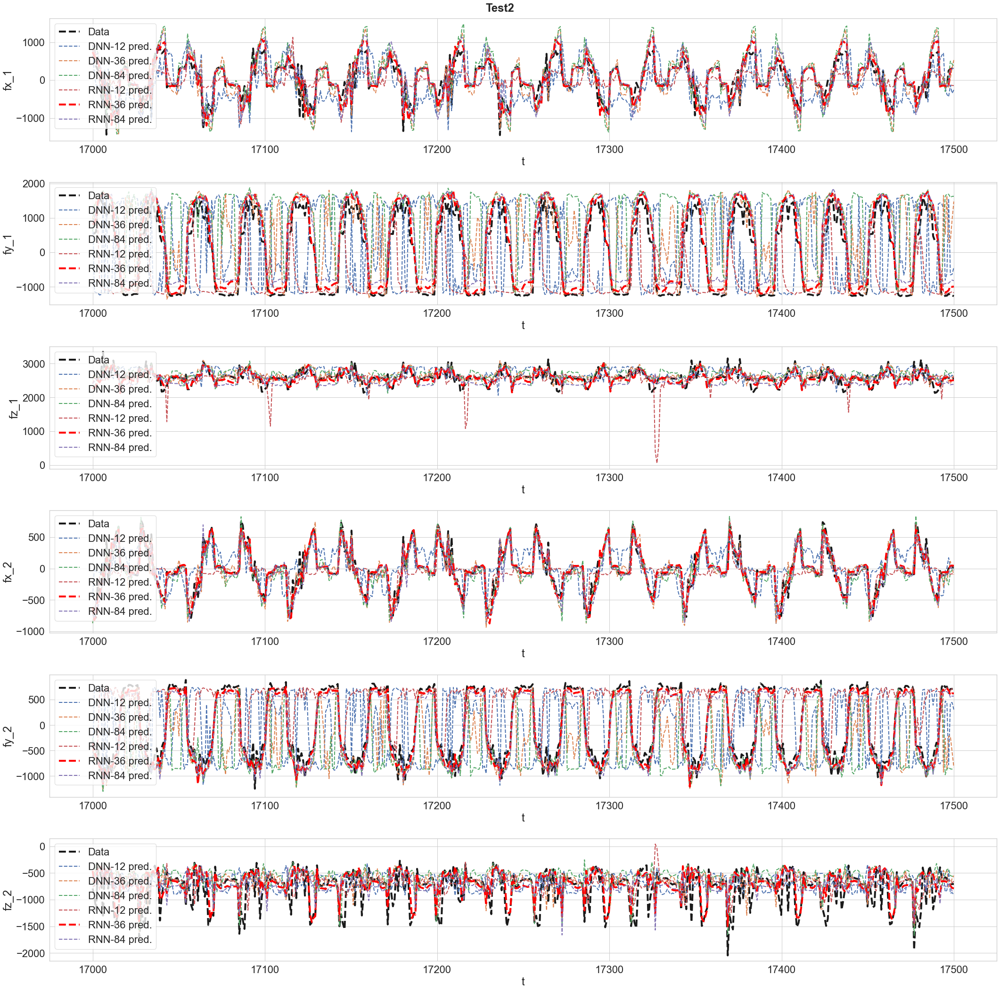

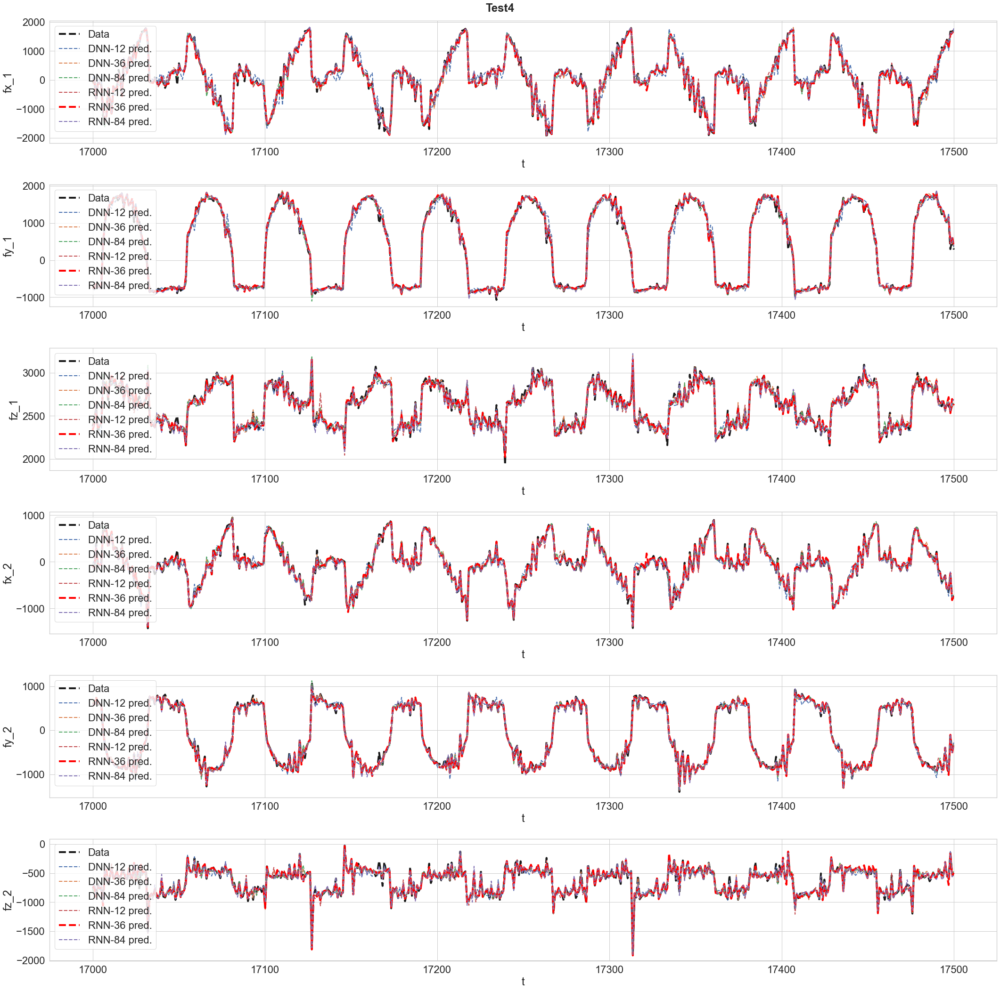

In [97]:
plot_timeseries(tmin=17000, tmax=17500)

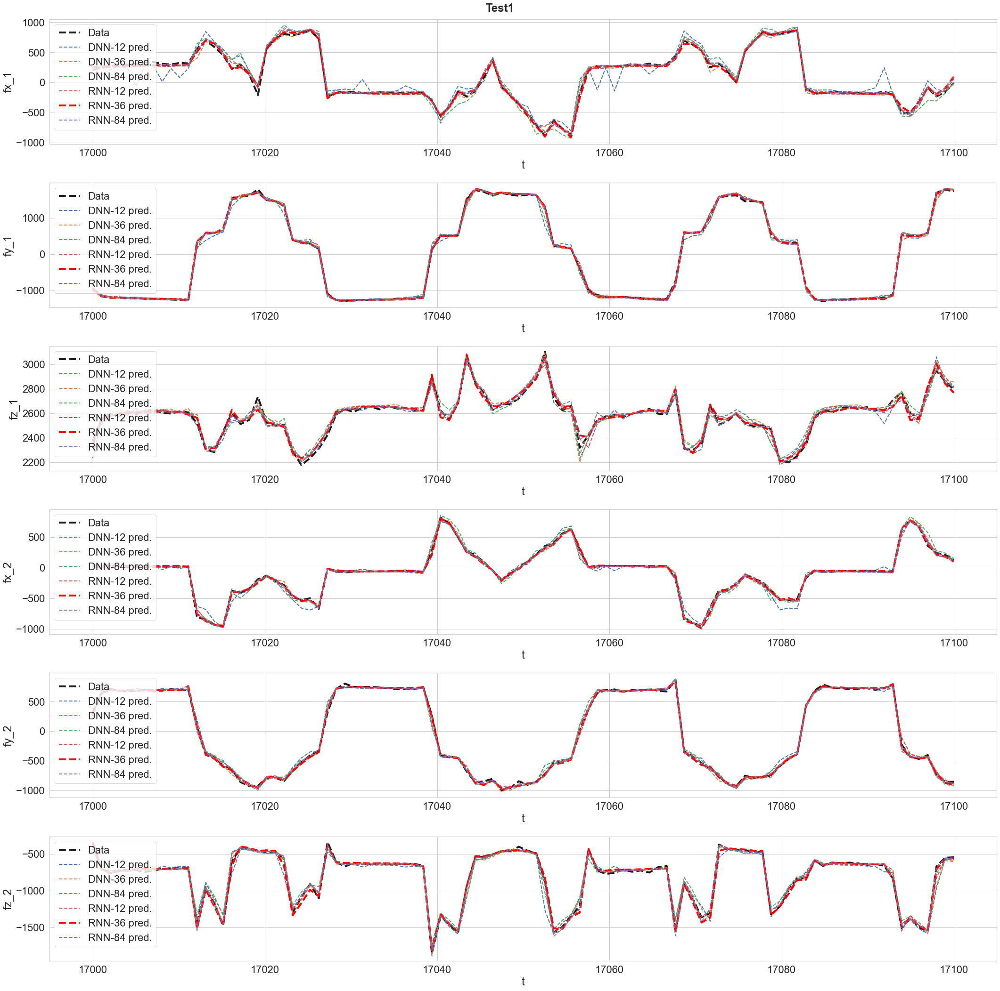

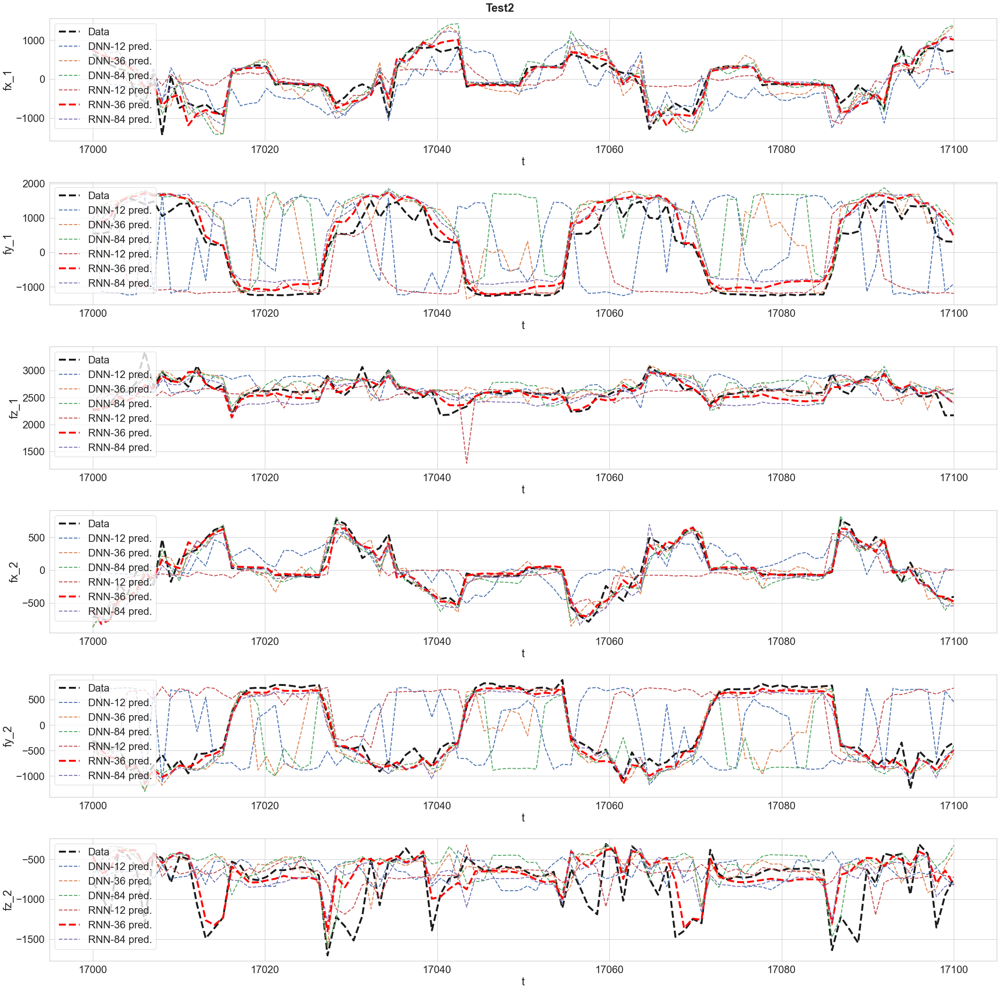

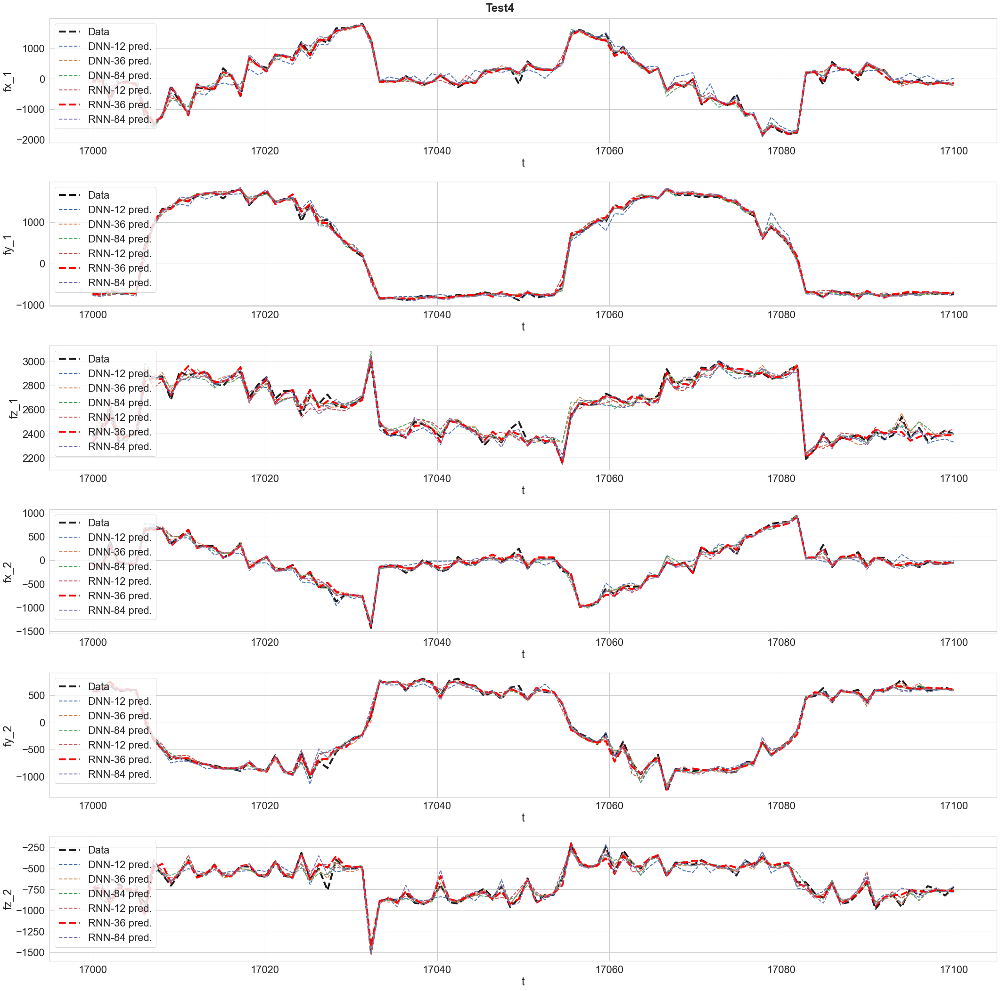

In [98]:
plot_timeseries(tmin=17000, tmax=17100)

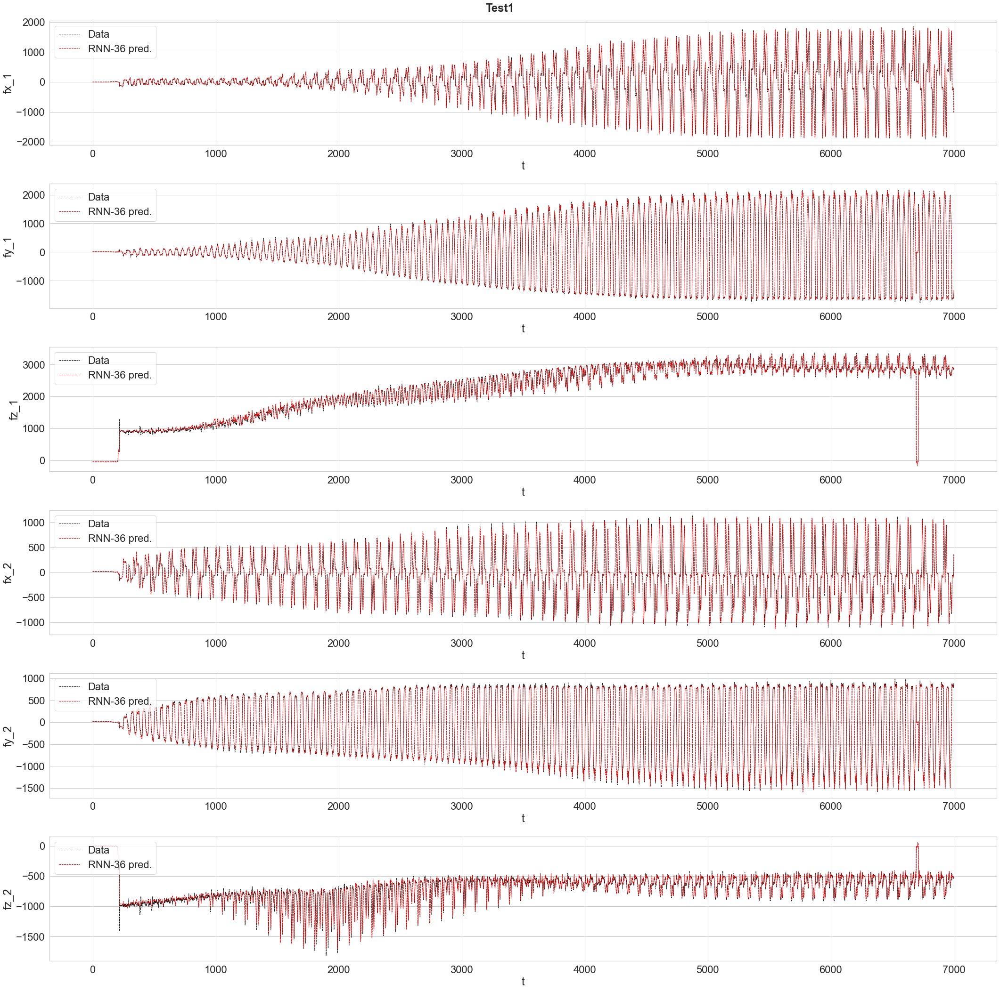

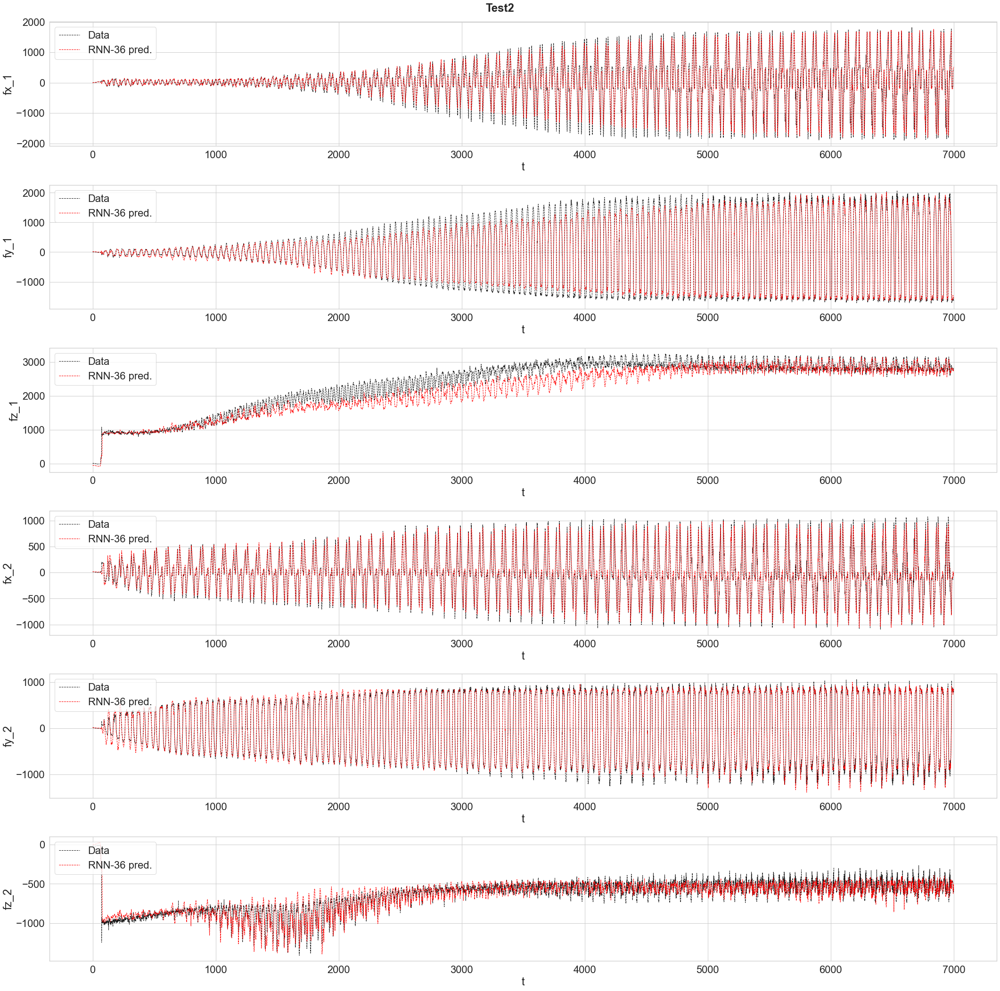

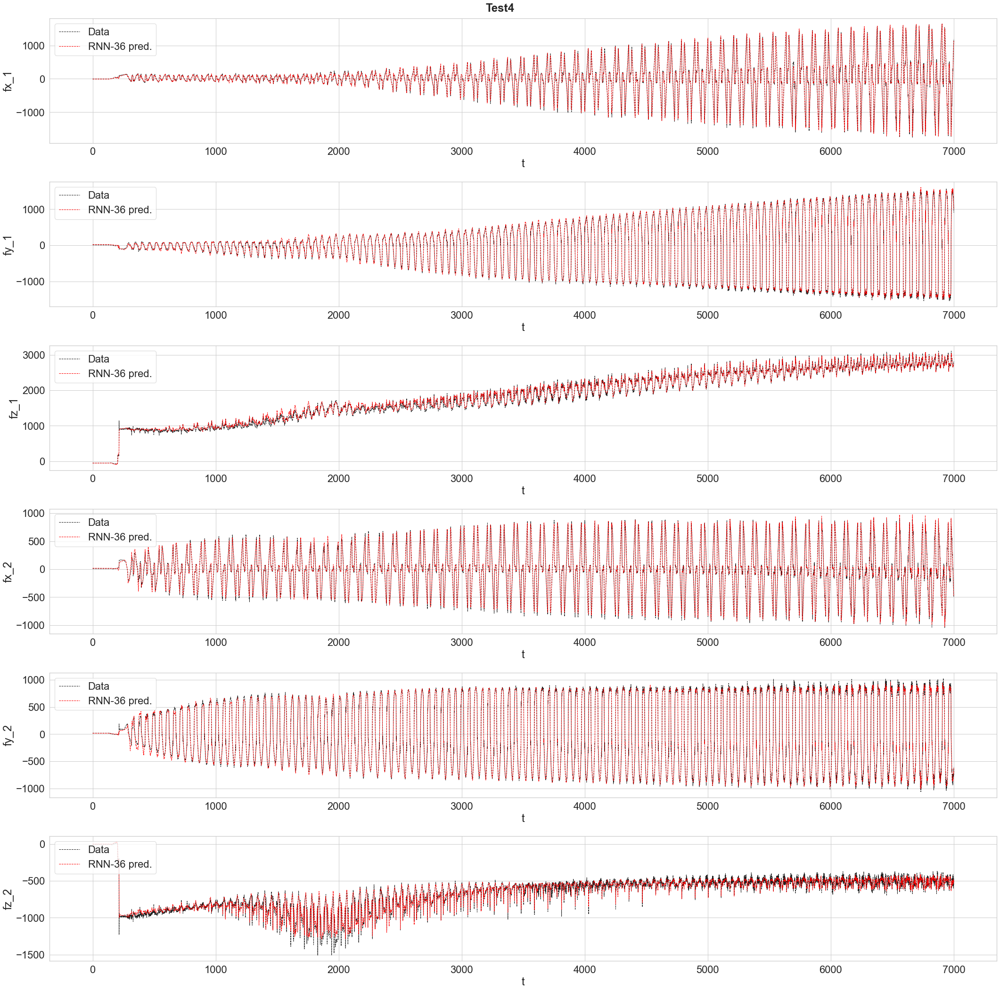

In [99]:
# plot large range for best model
tmin = 0
tmax = 7000
t = np.linspace(tmin, tmax, tmax-tmin)
sns.set(font_scale = 2)
sns.color_palette()
sns.set_style("whitegrid")
linewidth=1
for filename in dataset_filenames:

    fig = plt.figure(figsize=(30,30))
    fig.suptitle(filename, weight='bold').set_fontsize('24')
    for i in range(6):
        ax = fig.add_subplot(6, 1, i+1)
        ax.plot(t, tests_12[filename]['Y'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='Data', linestyle='dashed', linewidth=linewidth, color='k')
        #ax.plot(t, tests_12[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-12 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_36[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-36 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_84[filename]['Y_pred'].T[i][tmin+n_steps-1:tmax+n_steps-1], label='DNN-84 pred.', linestyle='dashed', linewidth=linewidth)
        #ax.plot(t, tests_12[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-12 pred.', linestyle='dashed', linewidth=linewidth)
        ax.plot(t, tests_36[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-36 pred.', linestyle='dashed', linewidth=linewidth, color='red')
        #ax.plot(t, tests_84[filename]['Y_seq_pred'].T[i][tmin:tmax], label='RNN-84 pred.', linestyle='dashed', linewidth=linewidth)
        ax.set_xlabel('t')
        ax.set_ylabel(outputs[i])
        ax.legend(loc=2)
    plt.tight_layout()
    plt.savefig(output_dir/'{}_timeseries_t{}to{}.pdf'.format(filename, tmin, tmax))

# 6. Summary and prospects

Six neural networks (three DNNs and three RNNs) were trained to predict tool-tip forces from input positions and angles (and their higher-order derivatives). The models were trained on 70% of the combined Test1 and Test4 datasets. Test2 was left out of the training entirely to evaluate the performance of the models on unseen runs of the robots. 

The RNN models clearly outperformed the DNN models. This is especially clear from looking at the predicted tool-tip forces as a function of time for the Test2 dataset (unseen during training) above.

Adding the first-order (velocity) and second-order (acceleration) derivatives of the positions and angles as additional input features reduced the loss and significantly improved performance. Adding up to 6th order derivatives seemed helpful in some earlier DNN models (with fewer layers) that I trained (not shown in this notebook). However, the performance comparisons between DNN-84 and DNN-36 in this notebook indicate that the impact is marginal.

Although the RNN did a decent job, all models struggled in generalizing to Test2. A more comprehensive hyperparameter optimization could be done to improve the performance. Adding training data from more runs with robots would probably help a lot. 

You would probably want to further optimize and tailor the model to the application. A deeper (and recurrent) model will likely perform better if the goal is to achieve optimal accuracy. However, if the goal is to run fast inference on resource-constrained hardware, you'd want to optimize a smaller model that is *good enough* for the job. 